# NeurIPS data analysis - Protein (ADT) analysis of CITE-seq data sets

This notebook contains the preprocessing of the ADT part of the CITE-seq data sets. ADT stands for antibody derived tag and each antibody in the used panel binds to a specific protein on the cell surface. The counts correlate to the amount of protein present on the surface. If you've spend some time in labs, this can be closely related to FACS, which also uses surface proteins to define celltypes.

In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

import os

In [2]:
sc.set_figure_params(scanpy=True, dpi=60, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(7,7))

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [4]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [5]:
%R library(Seurat)

'SeuratOb...,'Seurat','tools',...,'datasets','methods','base'


# Load raw data

In [6]:
os.getcwd()

'/home/jovyan/project/neurips2021-notebooks/notebooks/templates'

In [7]:
os.chdir('/home/jovyan/project/neurips2021-notebooks/')

In [8]:
adata = sc.read_10x_h5('data/cite/raw_data/s1d1/filtered_feature_bc_matrix.h5', gex_only=False)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [9]:
adata.var['feature_types'].value_counts()

Gene Expression     36601
Antibody Capture      140
Name: feature_types, dtype: int64

In [10]:
adata_adt = adata[:,adata.var['feature_types'].isin(['Antibody Capture'])].copy()
#adata_gex = adata[:,adata.var['feature_types'].isin(['Gene Expression'])].copy()

In [11]:
del adata

In [12]:
adata_adt

AnnData object with n_obs × n_vars = 8785 × 140
    var: 'gene_ids', 'feature_types', 'genome'

## QC

### Metric description

- **total_counts:** Total number of ADTs in each cell: Should be chosen permissivly since the biological state of a cell can largly influence the amount of proteins present on the surface. Extremely low might indicate sequencing problems, extremly high might indicate the presence of antibodies "clumps" that got trapped in the droplet
- **n_antibodies_by_counts:** Number of Anibodies captured: Also choose permissively
- **iso_count:** Number of reads from non-specific antibodies: Low counts might indicate cell/sequencing issues independent of biological state. This metric is less useful though if experiment was successful and there was hardly any non-specific binding.

In [13]:
sc.pp.calculate_qc_metrics(
    adata_adt,
    percent_top=(5,10),
    var_type="antibodies",
    inplace=True,
)

In [14]:
iso_abs = [a for a in adata_adt.var_names if any(['Mouse' in a, 'Rat' in a])]

In [15]:
iso_count = list(adata_adt[:,iso_abs].X.toarray().sum(axis=1))

In [16]:
adata_adt.obs['iso_count'] = iso_count

In [17]:
#generate count for coloring
adata_adt.obs['iso_count_col'] = [c if c < np.percentile(iso_count, 99) else np.percentile(iso_count, 99)+1 for c in iso_count] 
adata_adt.obs['log_iso_count'] = np.log10(iso_count)

<ipython-input-17-15255ce3c738>:3: RuntimeWarning: divide by zero encountered in log10
  adata_adt.obs['log_iso_count'] = np.log10(iso_count)


In [18]:
adata_adt

AnnData object with n_obs × n_vars = 8785 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [19]:
adata_adt.obs.head()

,n_antibodies_by_counts,log1p_n_antibodies_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_5_antibodies,pct_counts_in_top_10_antibodies,iso_count,iso_count_col,log_iso_count
AAACCCAAGGATGGCT-1,124,4.828314,6483.0,8.777093,32.608360,53.000154,12.0,12.0,1.079181
AAACCCAAGGCCTAGA-1,140,4.948760,19711.0,9.888983,33.965806,50.048196,35.0,35.0,1.544068
AAACCCAAGTGAGTGC-1,120,4.795791,3349.0,8.116715,35.801732,54.523738,9.0,9.0,0.954243
AAACCCACAAGAGGCT-1,128,4.859812,7841.0,8.967249,50.618544,66.713429,8.0,8.0,0.903090
AAACCCACATCGTGGC-1,114,4.744932,2462.0,7.809135,43.135662,59.748172,0.0,0.0,-inf


In [20]:
# colors for highlighting min and max isocounts

from matplotlib import colors

colors1 = plt.cm.Blues_r(np.linspace(0, 0.1, 1))
colors2 = plt.cm.Reds(np.linspace(0, 1, 98))
colors3 = plt.cm.Purples_r(np.linspace(0,0.1,1))
colorsComb = np.vstack([colors1, colors2, colors3])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)


... storing 'feature_types' as categorical
... storing 'genome' as categorical


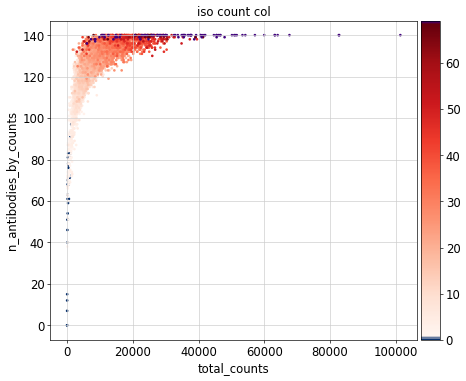

In [21]:
p1 = sc.pl.scatter(adata_adt,'total_counts', 'n_antibodies_by_counts',
                   color = 'iso_count_col', size=40, show=False, color_map=mymap)

plt.show()

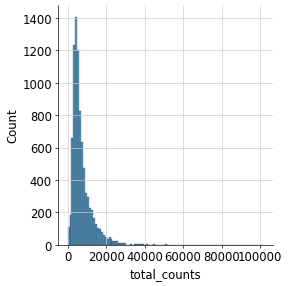

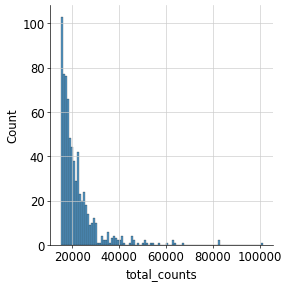

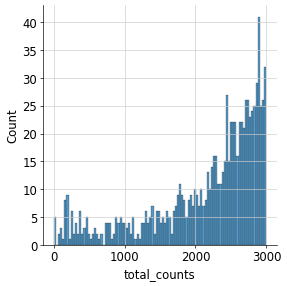

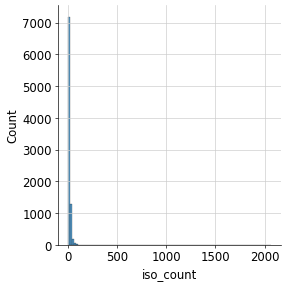

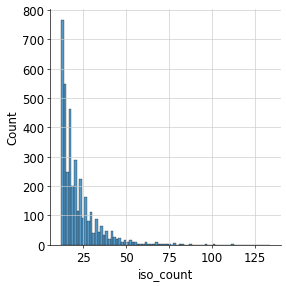

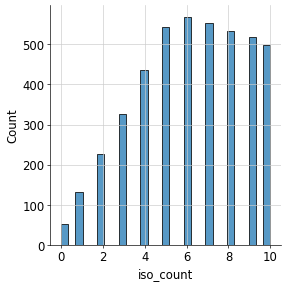

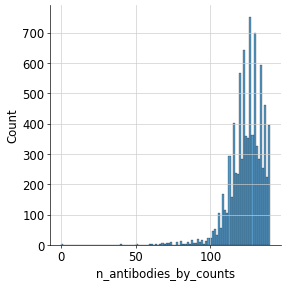

In [22]:
t1 = sns.displot(adata_adt.obs['total_counts'], bins=100, kde=False)
t2 = sns.displot(adata_adt.obs.loc[adata_adt.obs['total_counts']>15000,'total_counts'], bins=100, kde=False)
t2 = sns.displot(adata_adt.obs.loc[adata_adt.obs['total_counts']<3000,'total_counts'], bins=100, kde=False)

t3 = sns.displot(adata_adt.obs['iso_count'], bins=100, kde=False)
#t4 = sns.displot(adata_adt.obs['log_iso_count'], bins=100, kde=False)
t6 = sns.displot(adata_adt.obs.loc[np.logical_and(adata_adt.obs['iso_count'] > np.percentile(iso_count, 50),
                                   adata_adt.obs['iso_count'] < np.percentile(iso_count, 99.5)),'iso_count'], bins=80, kde=False)
t7 = sns.displot(adata_adt.obs.loc[adata_adt.obs['iso_count'] < np.percentile(iso_count, 50),'iso_count'], bins=29, kde=False)

t8 = sns.displot(adata_adt.obs['n_antibodies_by_counts'], bins=100, kde=False)

plt.show()

The plots above show that the quality of the ADT data is high since hardly any unspecific binding could take place in almost all cells. We therefore only filter out very high and low counts and cells with less than 80 captured antibodies. We use the isotype control only to filter out cells with 0 counts and more then 100 iso-ADT counts, in case it is cells containing antibody clusters.
In general we can fiter out a bit more on the high count side, since these might correspond to doublets.

... storing 'iso_count_fltr' as categorical


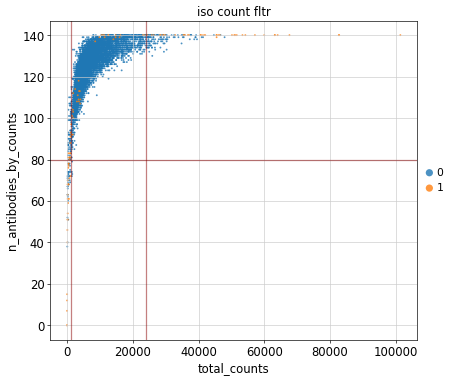

In [23]:
lower_count_thresh = 1200 #1200 #(700)
upper_counts_thresh = 24000 # 27500 #31500 #31500
lower_features_thresh = 80

lower_iso_count_thresh = 0
upper_iso_count_thresh = 100

# color by iso count filter
adata_adt.obs['iso_count_fltr'] = ['0' if (c > lower_iso_count_thresh and c < upper_iso_count_thresh) else '1' for c in adata_adt.obs.iso_count]

p2 = sc.pl.scatter(adata_adt, 'total_counts', 'n_antibodies_by_counts', \
                   color = 'iso_count_fltr', size=20, show=False, alpha=0.8)

p2.axline((lower_count_thresh,0),(lower_count_thresh,1), color='darkred', alpha=0.5)
p2.axline((upper_counts_thresh,0),(upper_counts_thresh,1), color='darkred', alpha=0.5)
p2.axline((0,lower_features_thresh),(1,lower_features_thresh), color='darkred', alpha=0.5)
plt.show()

# Filter cells

In [24]:
adata_bkp = adata_adt.copy()
#adata_adt = adata_bkp.copy()

In [25]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_adt.n_obs))

sc.pp.filter_cells(adata_adt, min_counts = lower_count_thresh)
print('Number of cells after min count filter: {:d}'.format(adata_adt.n_obs))

sc.pp.filter_cells(adata_adt, max_counts = upper_counts_thresh)
print('Number of cells after max count filter: {:d}'.format(adata_adt.n_obs))

adata_adt = adata_adt[adata_adt.obs['n_antibodies_by_counts'] > lower_features_thresh]
print('Number of cells after n_feature filter: {:d}'.format(adata_adt.n_obs))

adata_adt = adata_adt[adata_adt.obs['iso_count_fltr'] == '0']
print('Number of cells after iso_count filter: {:d}'.format(adata_adt.n_obs))


Total number of cells: 8785
Number of cells after min count filter: 8659
Number of cells after max count filter: 8492
Number of cells after n_feature filter: 8488
Number of cells after iso_count filter: 8455


In [26]:
# check if any antibody is detected in less than 20 cells
min(adata_adt.var.n_cells_by_counts)

3683

# Normalization - CLR implementation from Seurat

In [27]:
# Save raw counts
adata_adt.layers['counts'] = adata_adt.X.copy()

In [28]:
#Prepare for R input
cell_ids = adata_adt.obs_names
gene_ids = adata_adt.var_names

mat = adata_adt.X.T.A
mat_df = pd.DataFrame(mat, index=gene_ids, columns=cell_ids)

In [ ]:
%%R -i mat_df -o norm_mat

counts <- mat_df
cbmc <- CreateSeuratObject(counts = counts, assay='ADT')
cbmc <- NormalizeData(cbmc, normalization.method = "CLR", margin = 2)

norm_mat <- cbmc[['ADT']]@data

  |                                                  | 0 % ~calculating   |+                                                 | 0 % ~34s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~28s           |+                                                 | 0 % ~27s           |+                                                 | 0 % ~27s           |+                                                 | 0 % ~28s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~29s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~30s           |+                                                 | 0 % ~30s 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                            | 12% ~25s           |++++++                                     

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



  |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s           |++++++++++++++++++++++++++++                      | 54% ~12s 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s           |+++++++++++++++++++++++++++++++++                 | 65% ~10s  

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 6% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++            | 76% ~07s           |++++++++++++++++++++++++++++++++++++++      

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



 |+++++++++++++++++++++++++++++++++++++++++++       | 86% ~04s           |+++++++++++++++++++++++++++++++++++++++++++       | 86% ~04s           |+++++++++++++++++++++++++++++++++++++++++++       | 86% ~04s           |+++++++++++++++++++++++++++++++++++++++++++       | 86% ~04s           |+++++++++++++++++++++++++++++++++++++++++++       | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s           |++++++++++++++++++++++++++++++++++++++++++++      | 86% ~04s  

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



  |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |++++++++++++++++++++++++++++++++++++++++++++++++  | 96% ~01s           |+++++++++++++++++++++++++++++++++++++++++++++++++ | 96% ~01s           |+++++++++++++++++++++++++++++++++++++++++++++++++ | 96% ~01s           |+++++++++++++++++++++++++++++++++++++++++++++++++ | 96% ~01s           |+++++++++++++++++++++++++++++++++++++++++++++++++ | 96% ~01s 

In [ ]:
adata_adt.X = norm_mat.T

In [ ]:
#sc.pp.scale(adata_minR, max_value=10)

In [ ]:
sc.pp.pca(adata_adt, n_comps=50)

In [33]:
sc.pp.neighbors(adata_adt, n_neighbors=20)

In [34]:
sc.tl.leiden(adata_adt)

In [35]:
sc.tl.umap(adata_adt)

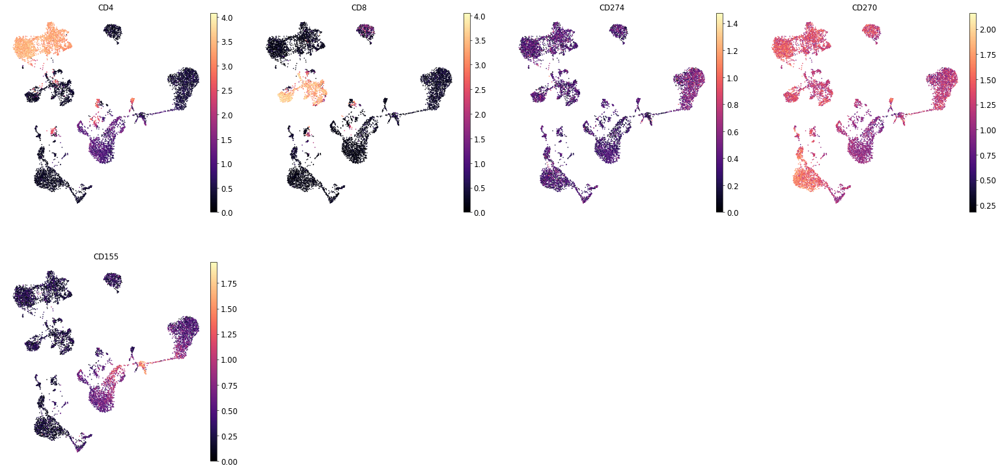

In [36]:
# plot few markers to check output
sc.pl.umap(adata_adt, color=['CD4','CD8', 'CD274', 'CD270','CD155'], color_map ='magma') #,'Rat-IgG1','Mouse-IgG2a'

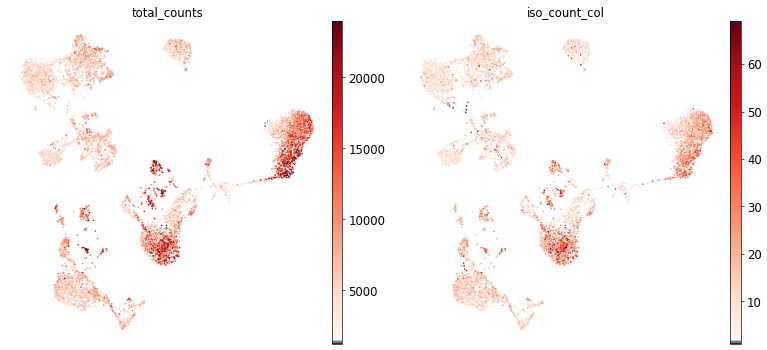

In [37]:
sc.pl.umap(adata_adt, color=['total_counts', 'iso_count_col'], color_map=mymap)

There's a very clear separation between CD4 and CD8 T cells with additional substructure.
The lower plots indicate some cell clusters in the middle high counts, potentially indicating doublet. This we will assess by marker gene expression.

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [38]:
sc.tl.leiden(adata_adt, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_adt, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_adt, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_adt, resolution=1, key_added='leiden_res1')

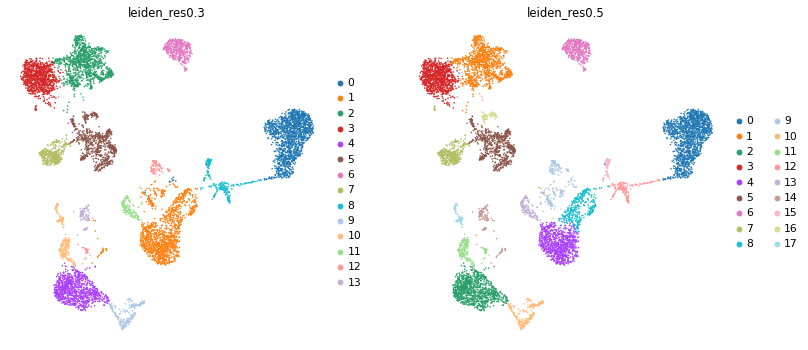

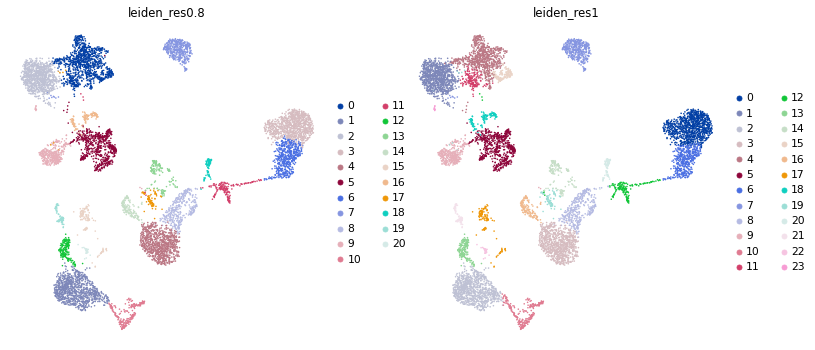

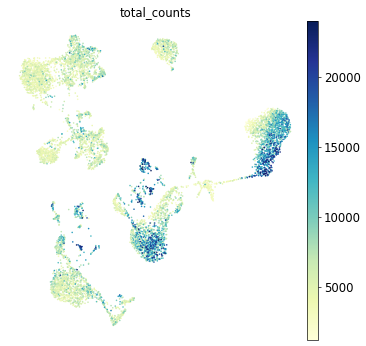

In [39]:
sc.pl.umap(adata_adt, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_adt, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_adt, color='total_counts')

### Choose initial resolution

In [40]:
# choose initial clustering resolition here:

orig_res = 'leiden_res0.5'

Check which clusters have the problematic aggregation of high-count cells... these might be difficult to annotate and could be doublets.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).
Note that for GEX data it is recommended to use raw counts as an input. In ADT data, this only returnes a very low number of cells with high doublet scores. When using the CLR transformed data, the number of predicted doublets becomes much closer to what we would expect (around 8-10 % for 8-9 thousand cells).

In [41]:
test_dat = adata_adt.copy()
#test_dat.X = test_dat.layers['counts']

In [42]:
sc.external.pp.scrublet(test_dat, n_prin_comps=24, expected_doublet_rate = 0.08)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.24
Detected doublet rate = 4.8%
Estimated detectable doublet fraction = 80.0%
Overall doublet rate:
	Expected   = 8.0%
	Estimated  = 6.0%


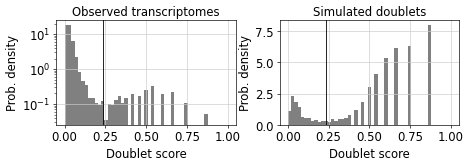

In [43]:
sc.external.pl.scrublet_score_distribution(test_dat)

plt.show()

The distribution of simulated doublets show that potentially a score over 0.25 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [44]:
adata_adt.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_adt.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [45]:
del test_dat

... storing 'predicted_doublet' as categorical


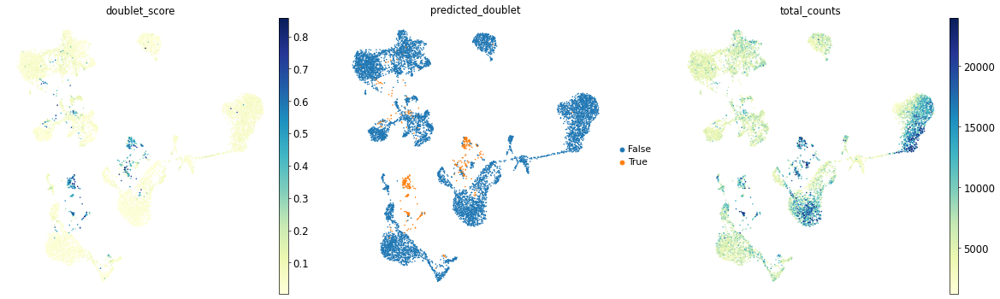

In [46]:
sc.pl.umap(adata_adt, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker proteins

In [47]:
high_level_markers = {
    
    'Erythro linage' : ['CD71'],
    'T' : ['CD3'],
    'B': ['CD40'],
    'Mono':['CD11b'],
    'Progen':['CD123']
}

In [224]:
marker_prots = {
    
    'CD14+ Mono': ['CD14', 'CD11b', 'CD62P'],
    'CD16+ Mono': ['CD11c', 'CD172a', 'CD88', 'CD85j'],
    'cDC2': ['CD11c',  'CD1c', 'FceRIa'],
    'pDCs': ['CD303', 'CD304'], 
    
    #Ery linage
    'Proerythroblast': ['CD105'],
    'Erythroblast': ['CD82', 'CD71'], # CD82 also in B
    'Normoblast/Reticulocyte': ['CD71'], 
    #'Reticulocyte': ['CD71'],  

    # B linage
    'Naive CD20+ B': ['IgD'],
    'B1 B': ['CD40', 'CD35', 'CD268', 'IgD'], # (IgD- !)
    'Transitional B': ['CD38', 'CD24'], # 'CD24', 'CD81', 'CD9'
    'Plasma cells': ['CD63', 'CD319'], 
    'Plasmablast': ['CD39', 'CD319'], # CD86

    # T linage
    'CD4+ T activated': ['CD4', 'CD45RO', 'CD25'], # CD25 negative, since these should be T regs
    'Treg':['CD25', 'CD39'],
    'CD4+ T naive': ['CD4', 'CD45RA'],
    
    'CD8+ T activated TIGIT+': ['CD8', 'CD45RO', 'TIGIT'],
    'CD8+ T activated CD69+': ['CD8', 'CD45RO', 'CD69'],
    'CD8+ T naive': ['CD8', 'CD45RA'],

    'gdT':['TCRVd2', 'CD161'],
    
    'NKT': ['TCRVa7.2'], #not 100% sure

    'NK': ['CD56', 'CD94', 'CD335'],  # 'CD57'?
    
    # Progenitors
    'ILC': ['CD127', 'CD103'], # CD103? also mentioned as Treg
    'MK/E prog':['CD112', 'CD105', 'CD352'],
    'HSC': ['CD13', 'CD155', 'CD112'],
    'Lymph prog':['CD112', 'CD81'], # close to HSC
    'G/M prog':['CD112', 'CD86']

}

In [49]:
sc.tl.rank_genes_groups(adata_adt, groupby=orig_res, key_added='rank_'+orig_res)

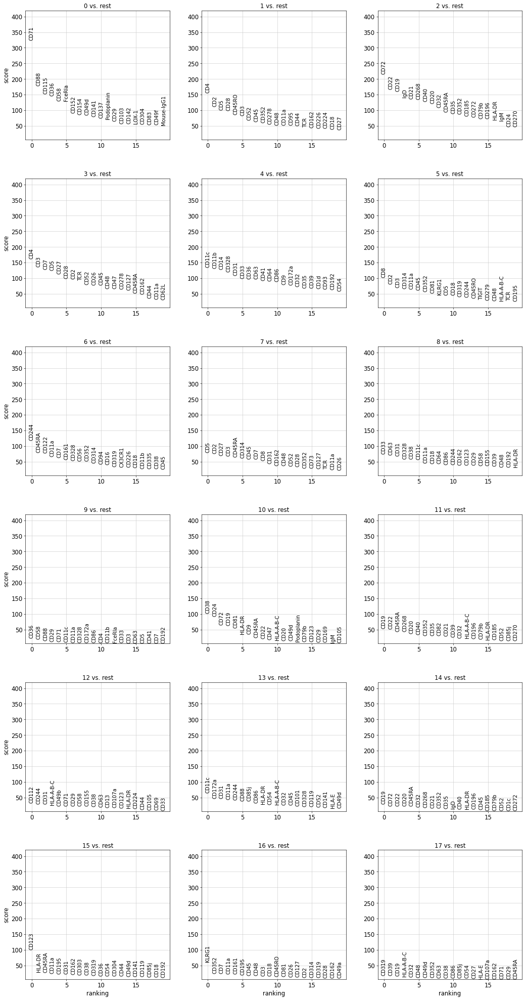

In [50]:
sc.pl.rank_genes_groups(adata_adt, key='rank_'+orig_res, ncols=3, fontsize=12)

## Plot literature markers

In [51]:
from matplotlib import colors

In [52]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap_red = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

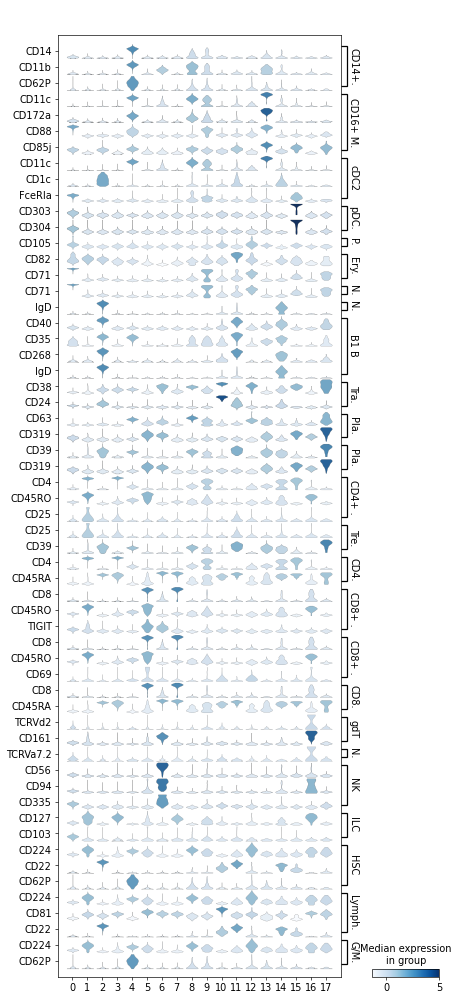

In [53]:
# Look at the marker genes in a concise manner
filt_marker_prots = dict()
for key,val in marker_prots.items():
    filt_vals = [i for i in val if i in adata_adt.var_names]
    filt_marker_prots[key] = filt_vals

adata_plot = adata_adt.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_prots, groupby=orig_res, use_raw=False, swap_axes=True)

Cluster: CD14+ Mono


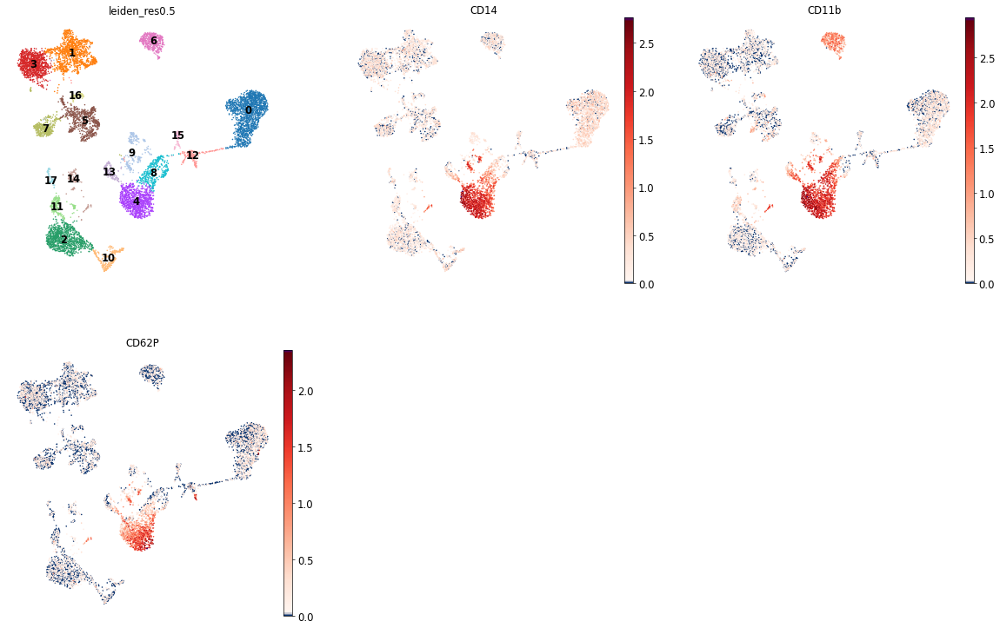

Cluster: CD16+ Mono


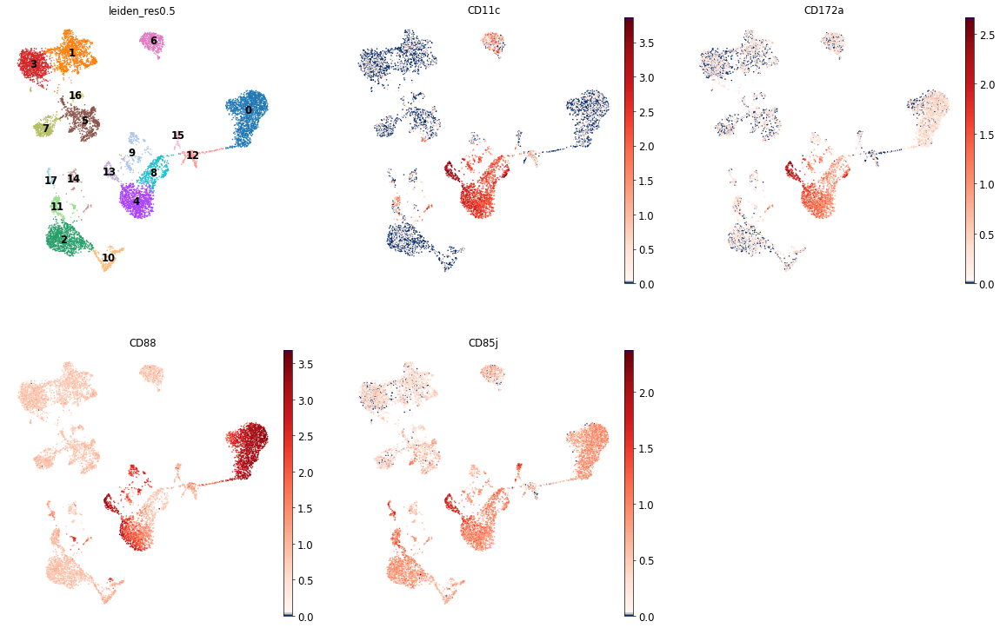

Cluster: cDC2


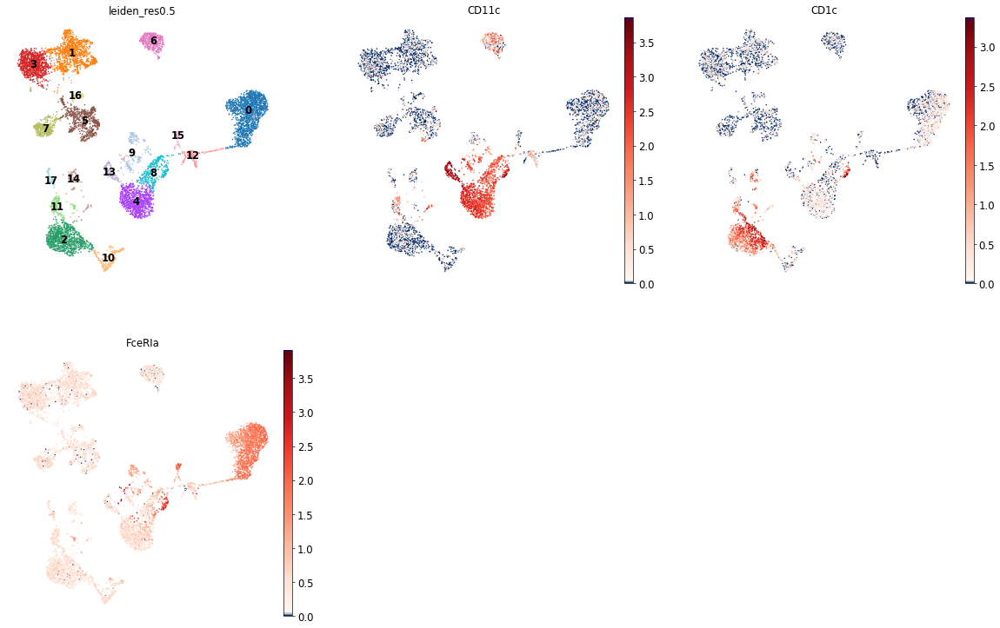

Cluster: pDCs


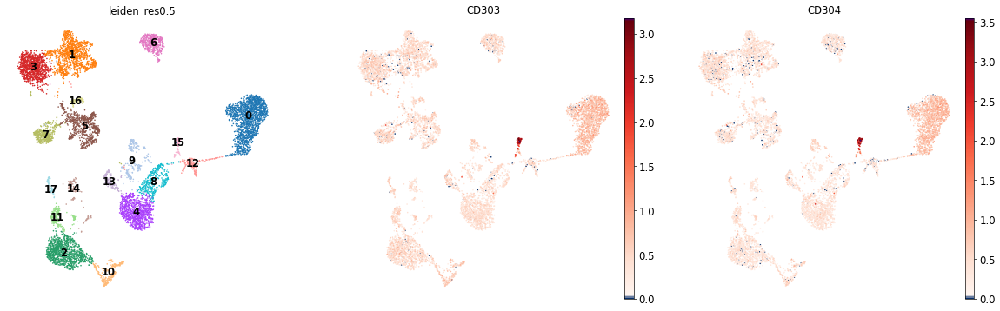

Cluster: Proerythroblast


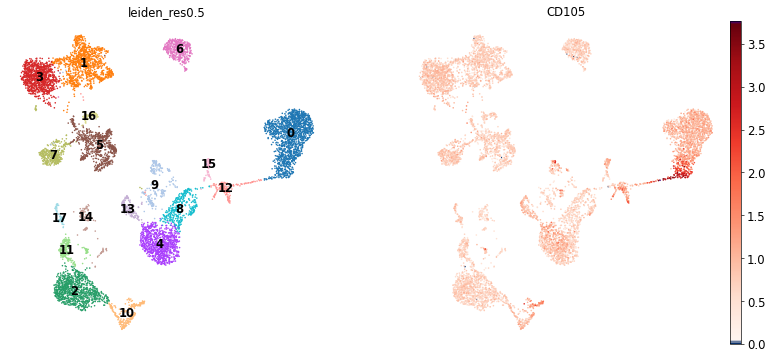

Cluster: Erythroblast


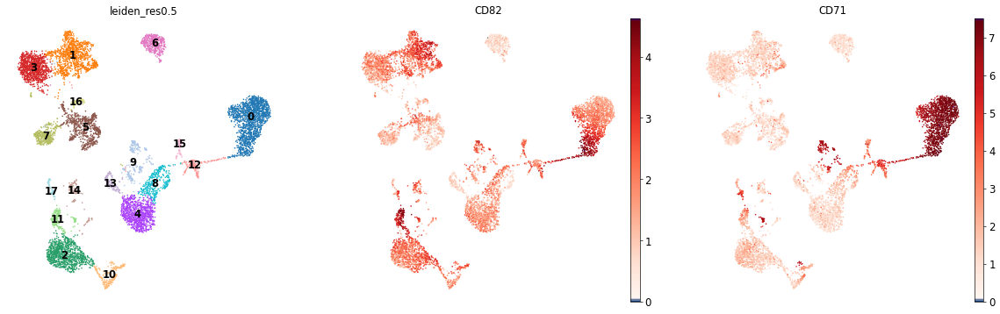

Cluster: Normoblast/Reticulocyte


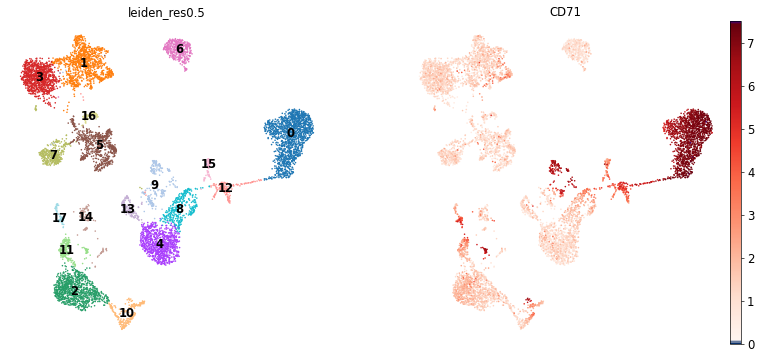

Cluster: Naive CD20+ B


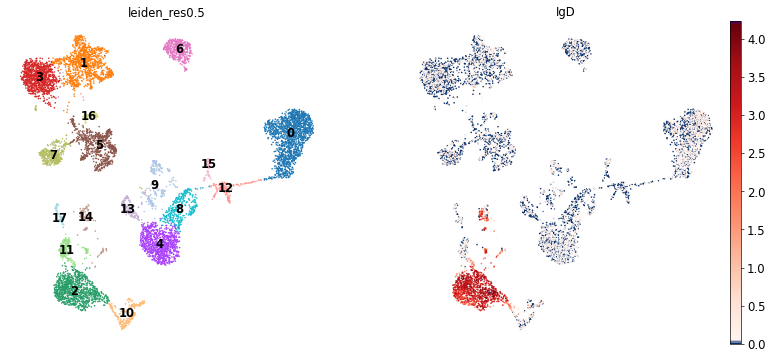

Cluster: B1 B


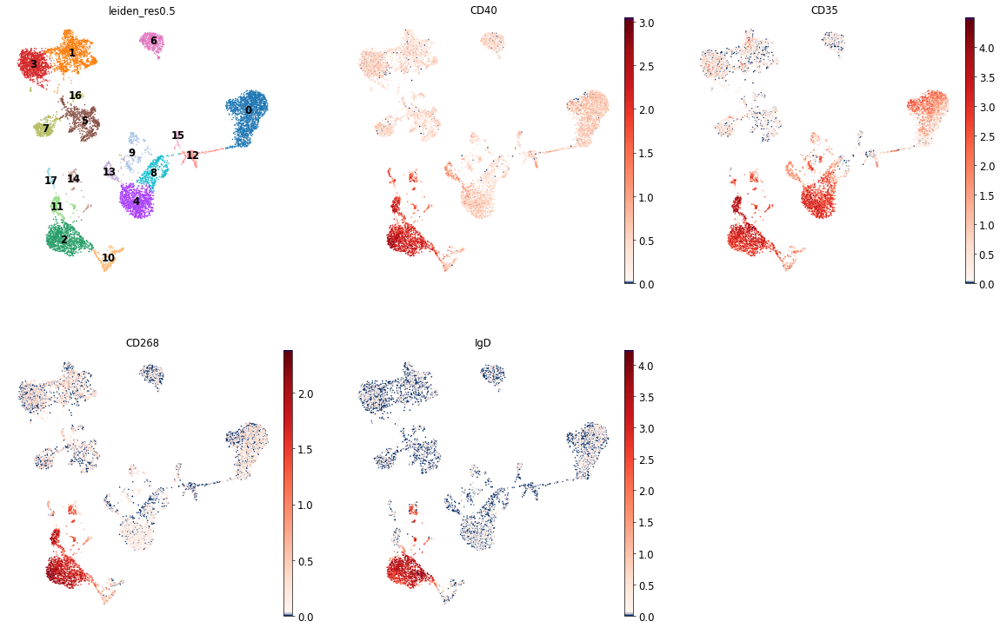

Cluster: Transitional B


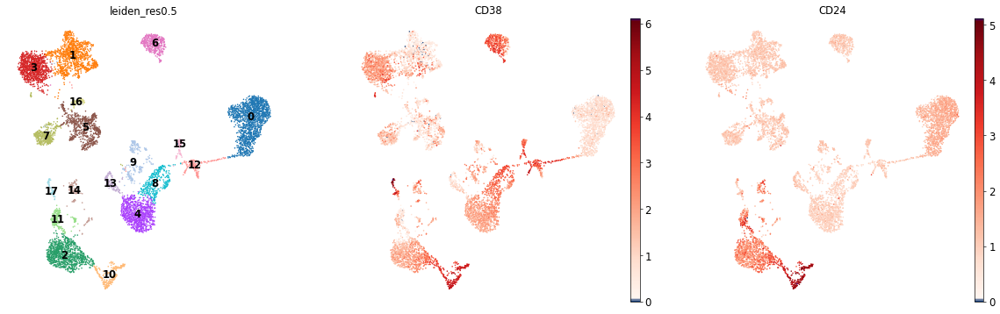

Cluster: Plasma cells


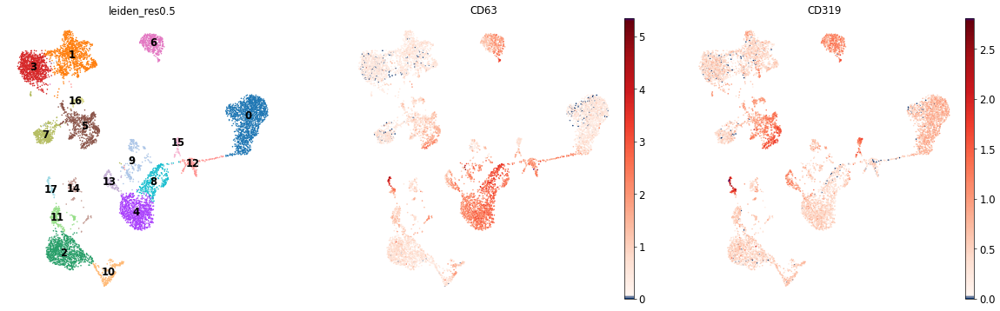

Cluster: Plasmablast


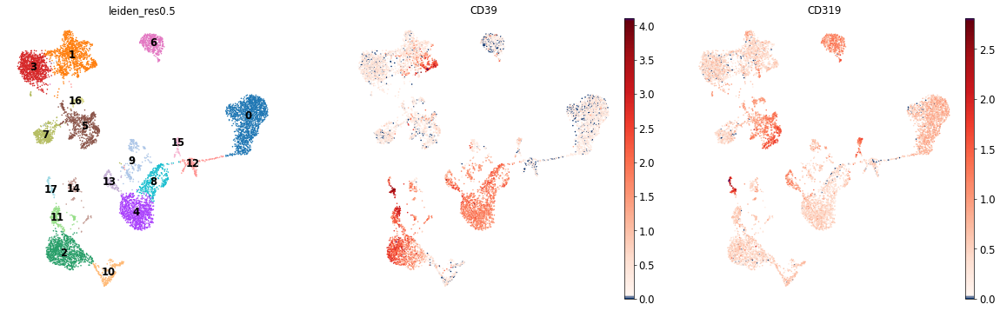

Cluster: CD4+ T activated


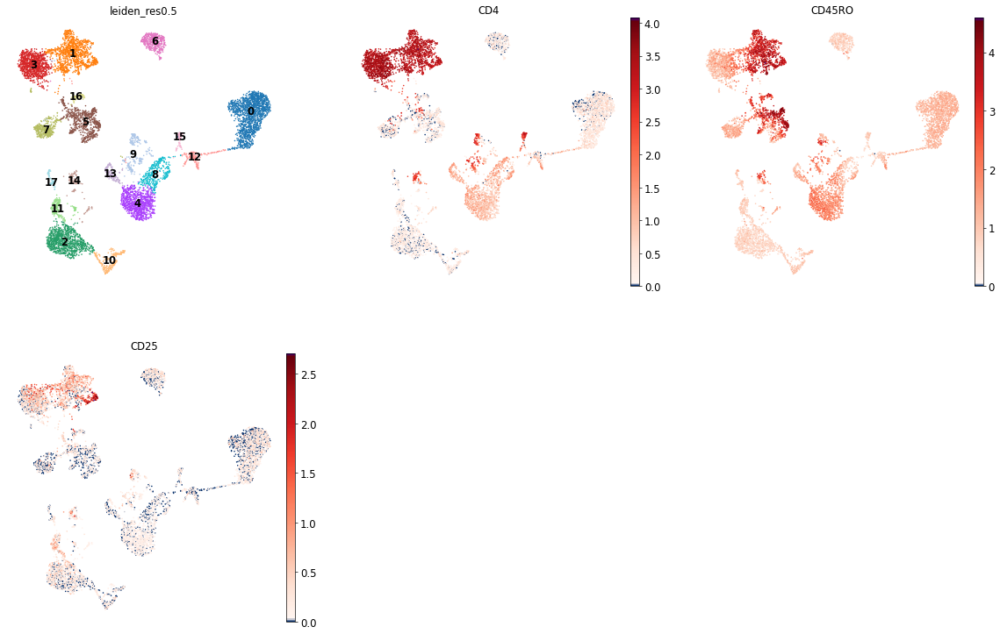

Cluster: Treg


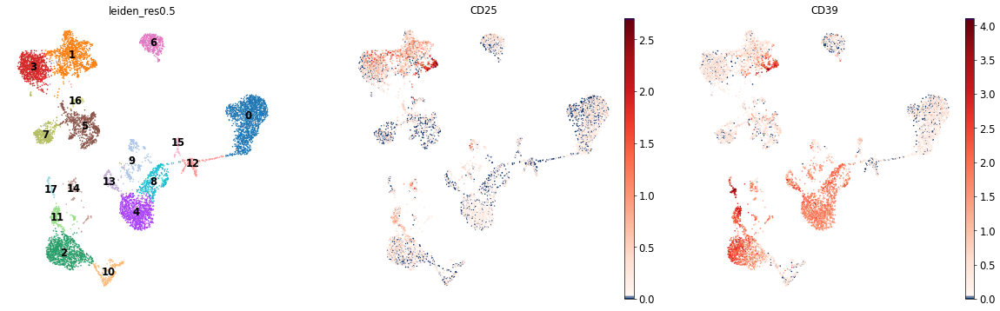

Cluster: CD4+ T naive


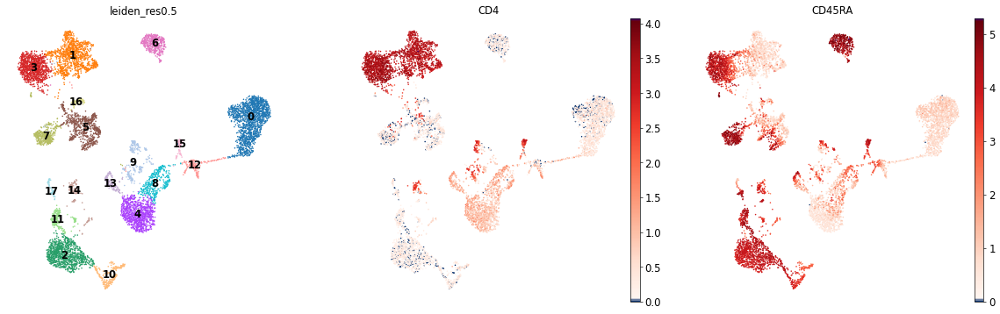

Cluster: CD8+ T activated TIGIT+


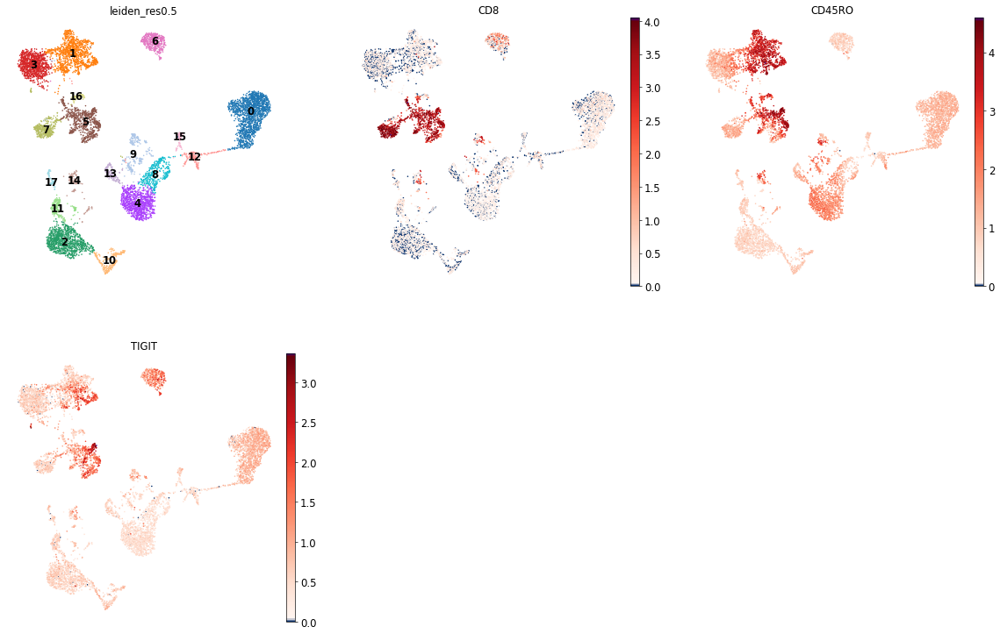

Cluster: CD8+ T activated CD69+


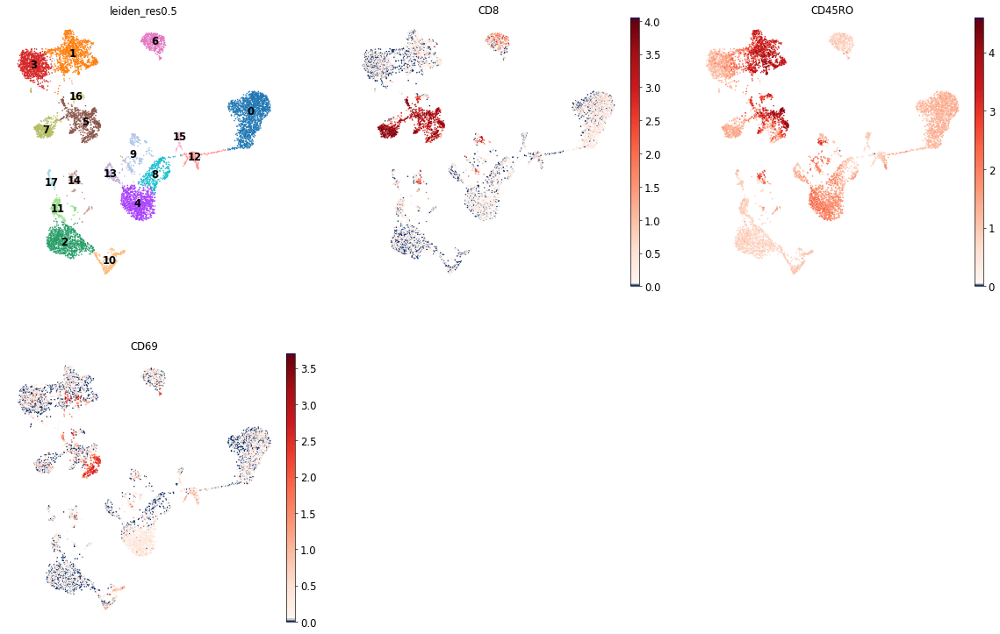

Cluster: CD8+ T naive


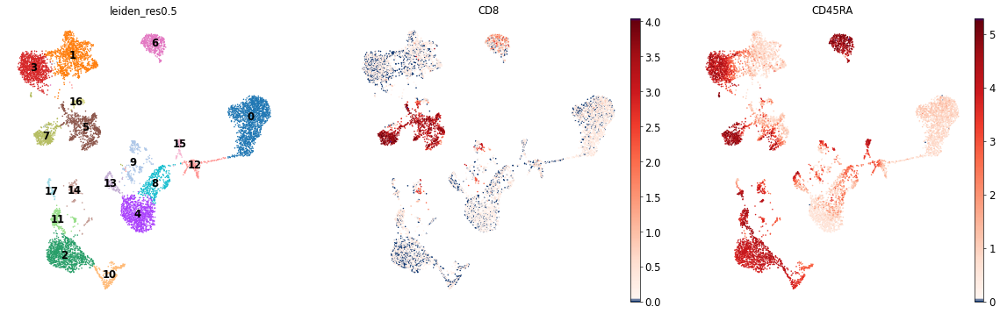

Cluster: gdT


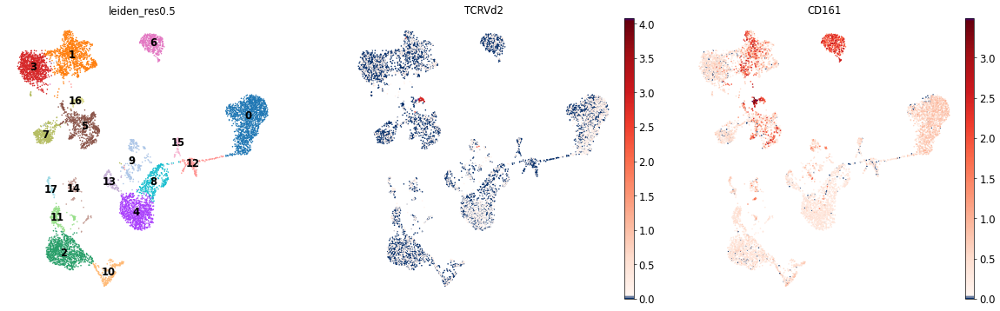

Cluster: NKT


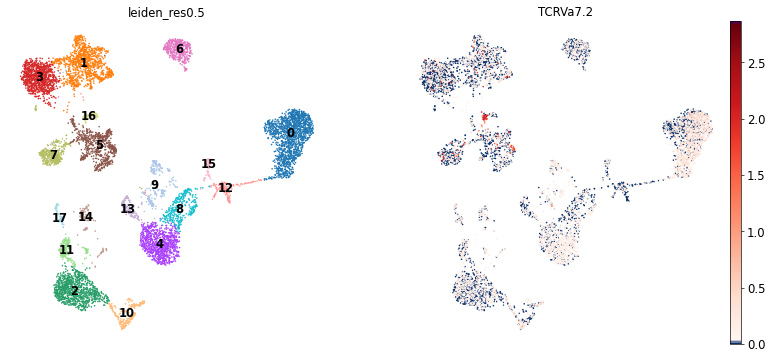

Cluster: NK


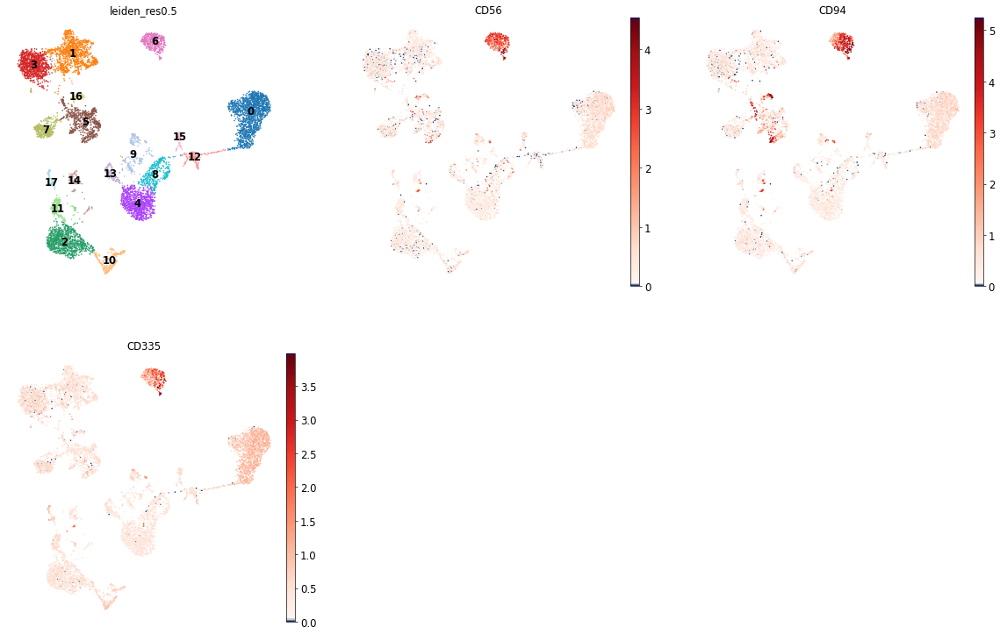

Cluster: ILC


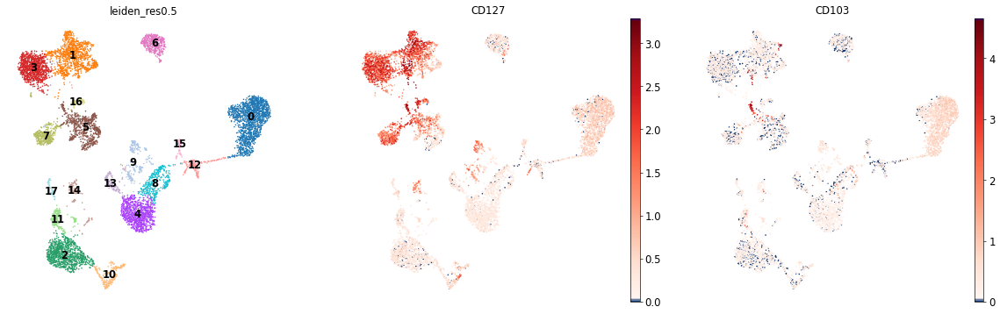

Cluster: MK/E prog


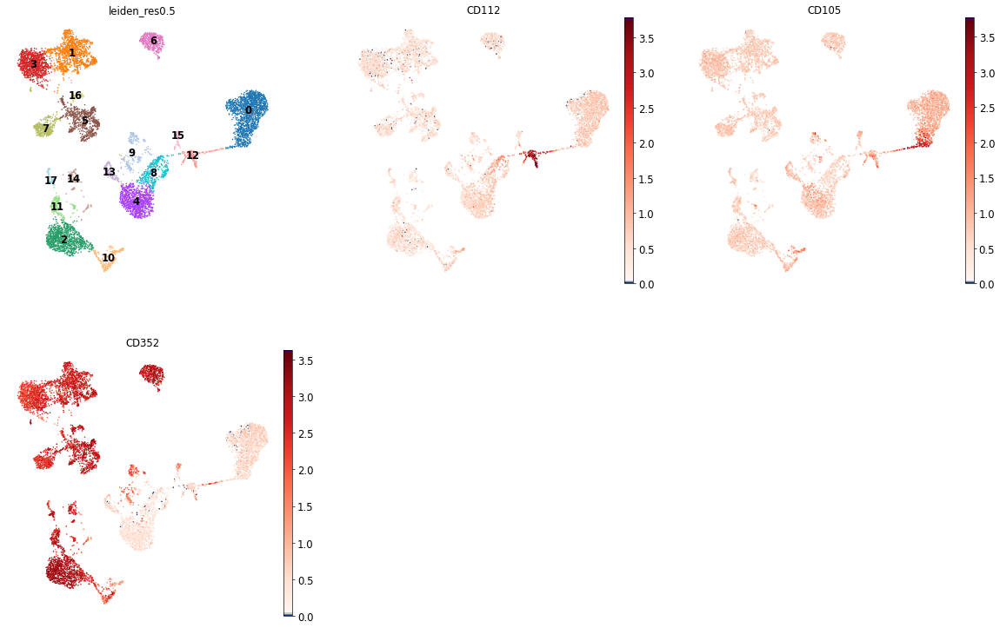

Cluster: HSC


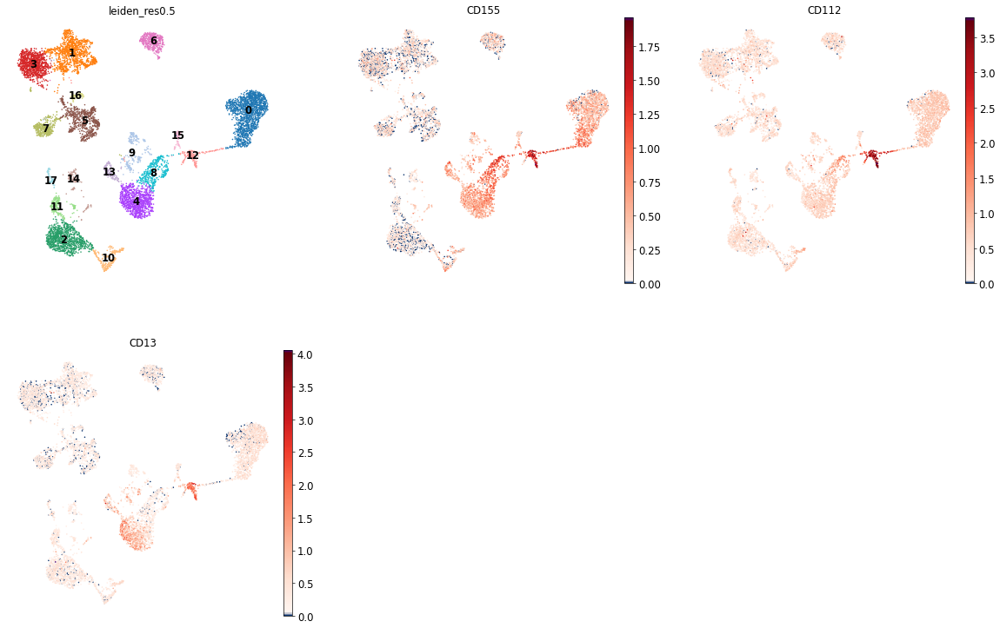

Cluster: Lymph prog


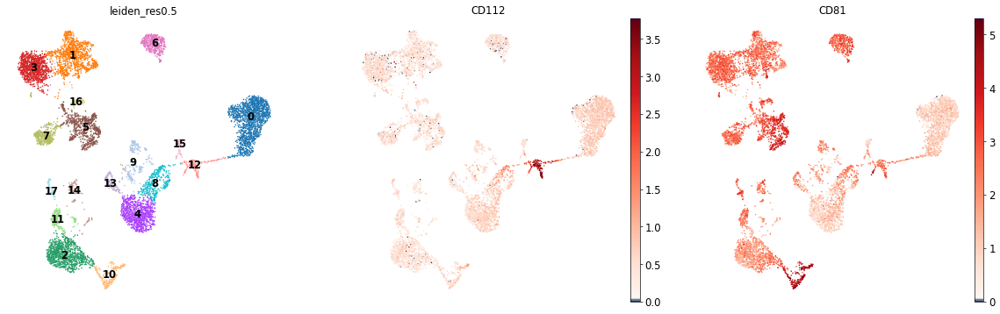

Cluster: G/M prog


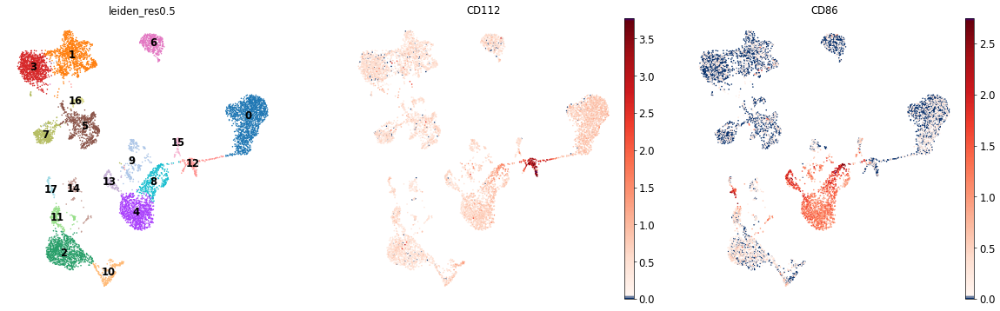

In [223]:
# Look at expression of all proteins
# Note that some markers are meant to be negative! (IgD for B1 B, CD25 for CD4+ T activated instead of Treg, 'CD22', 'CD62P' for HSCs)
for i in marker_prots.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_prots[i] if i in adata_adt.var_names]
    sc.pl.umap(adata_adt, color=[orig_res]+genes_to_plot, ncols=3, use_raw=False, cmap=mymap, legend_loc='on data')

Cluster: CD86


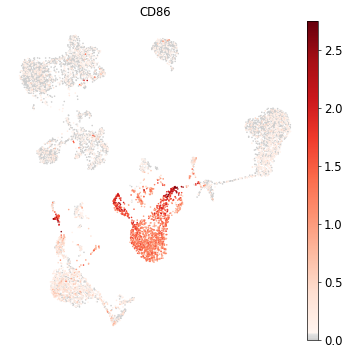

Cluster: CD274


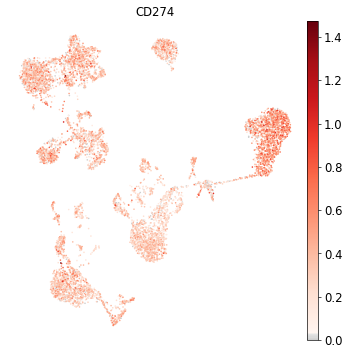

Cluster: CD270


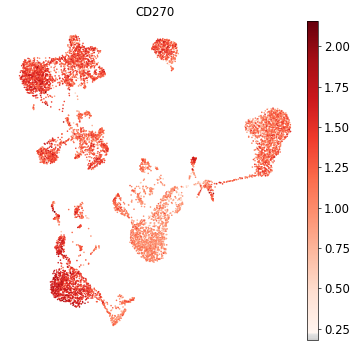

Cluster: CD155


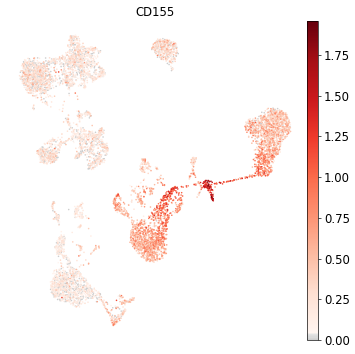

Cluster: CD112


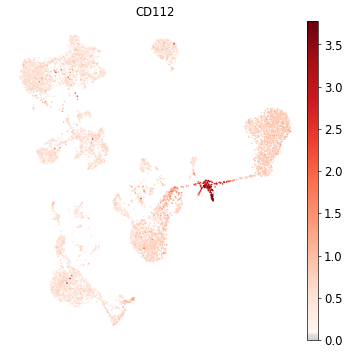

Cluster: CD47


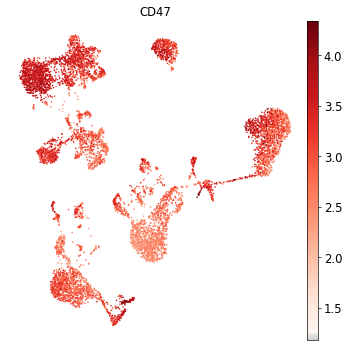

Cluster: CD48


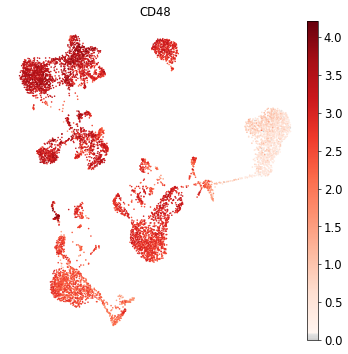

Cluster: CD40


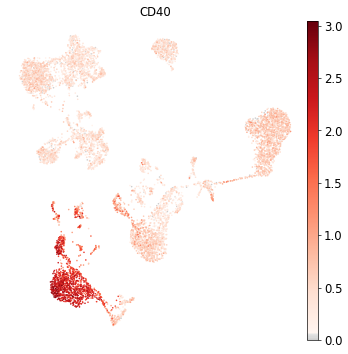

Cluster: CD154


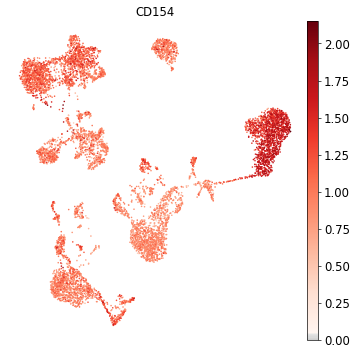

Cluster: CD52


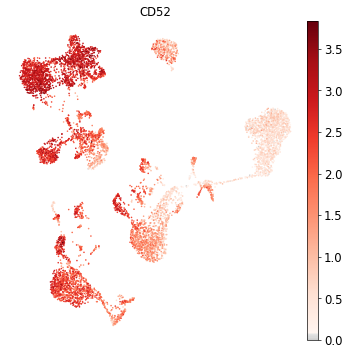

Cluster: CD3


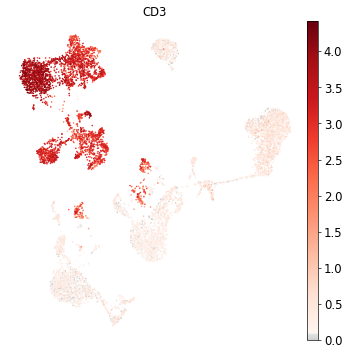

Cluster: CD8


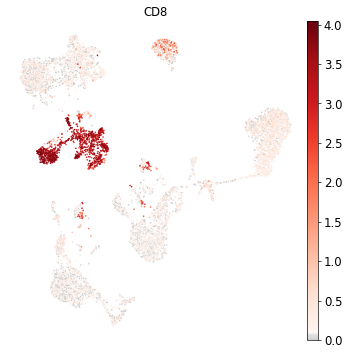

Cluster: CD56


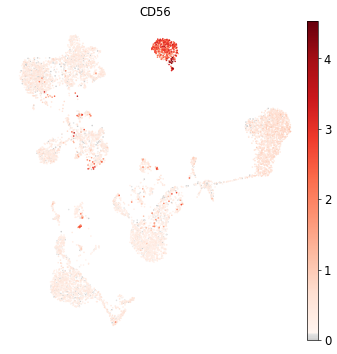

Cluster: CD19


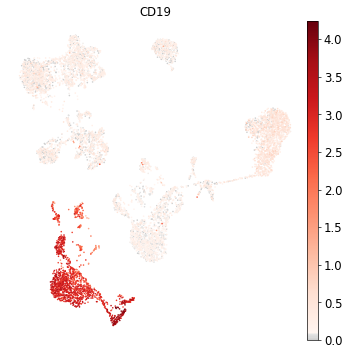

Cluster: CD33


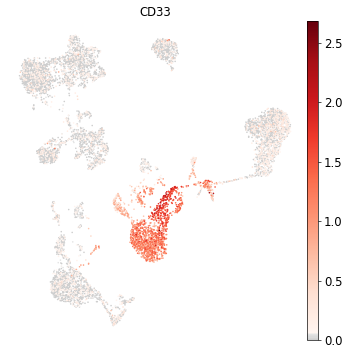

Cluster: CD11c


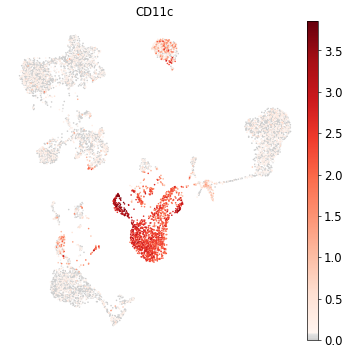

Cluster: HLA-A-B-C


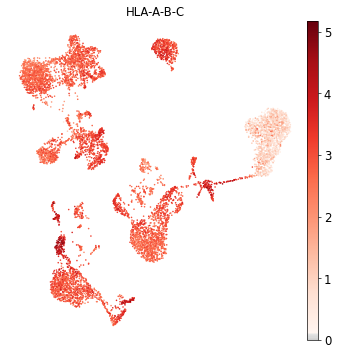

Cluster: CD45RA


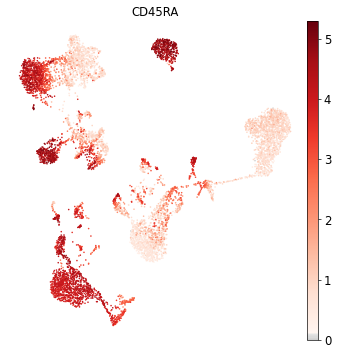

Cluster: CD123


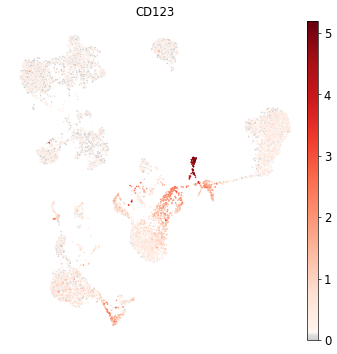

Cluster: CD7


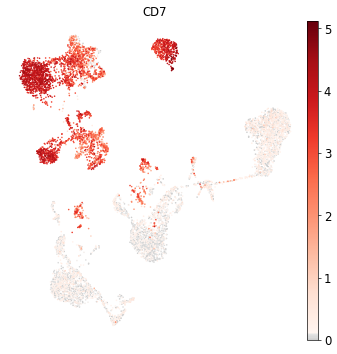

Cluster: CD105


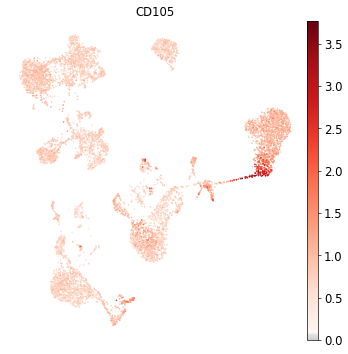

Cluster: CD49f


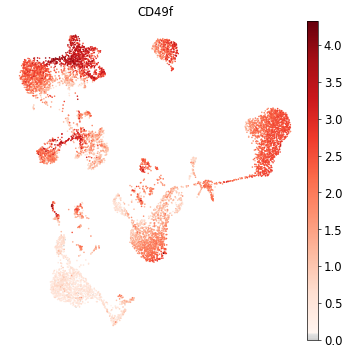

Cluster: CD194


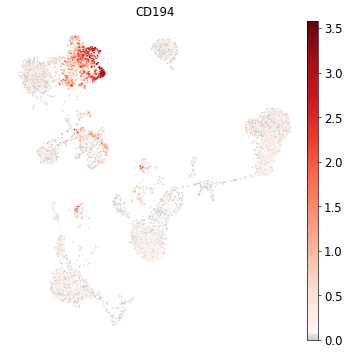

Cluster: CD4


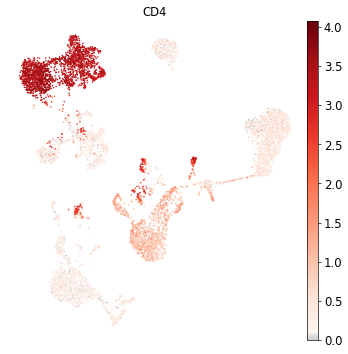

Cluster: CD44


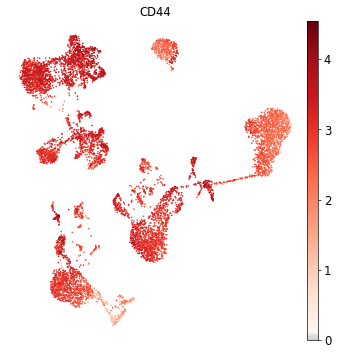

Cluster: CD14


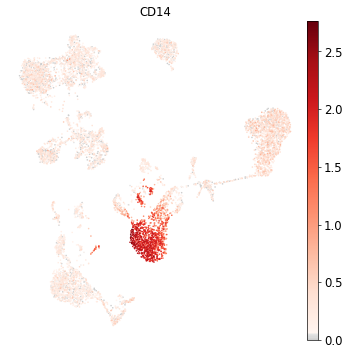

Cluster: CD16


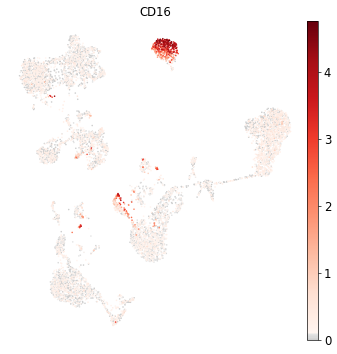

Cluster: CD25


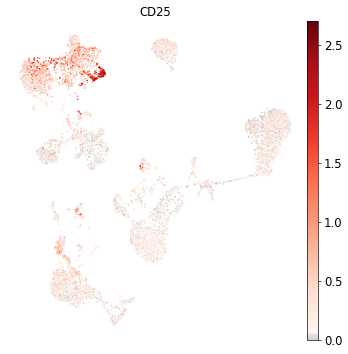

Cluster: CD45RO


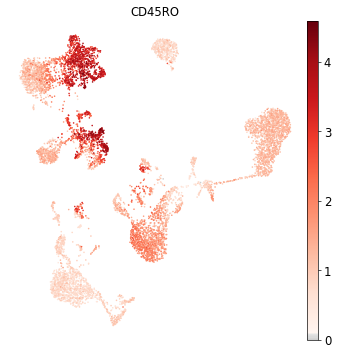

Cluster: CD279


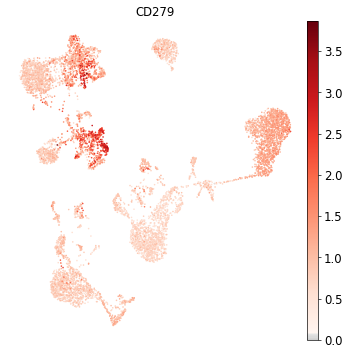

Cluster: TIGIT


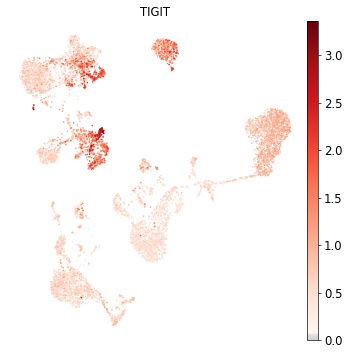

Cluster: Mouse-IgG1


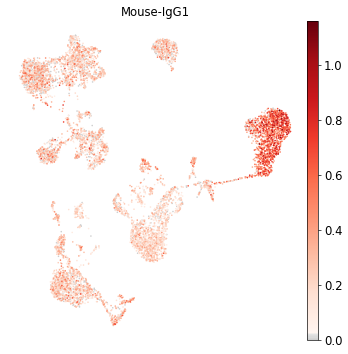

Cluster: Mouse-IgG2a


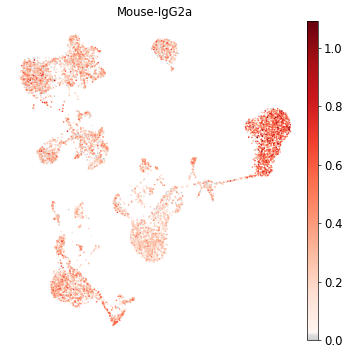

Cluster: Mouse-IgG2b


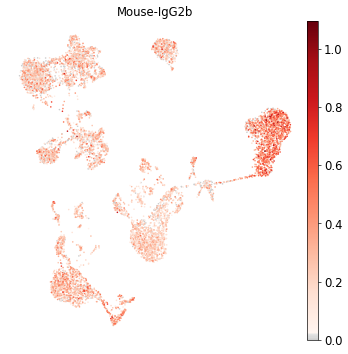

Cluster: Rat-IgG2b


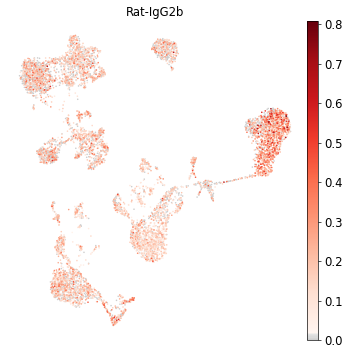

Cluster: CD20


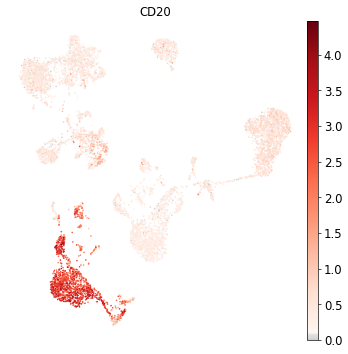

Cluster: CD335


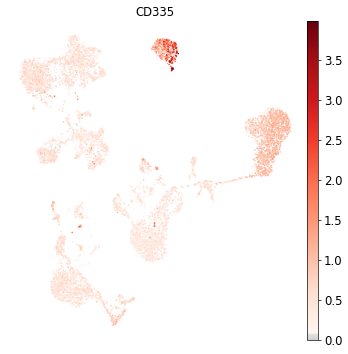

Cluster: CD31


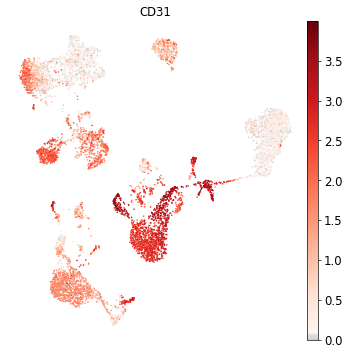

Cluster: Podoplanin


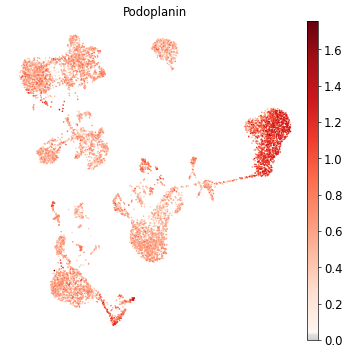

Cluster: CD146


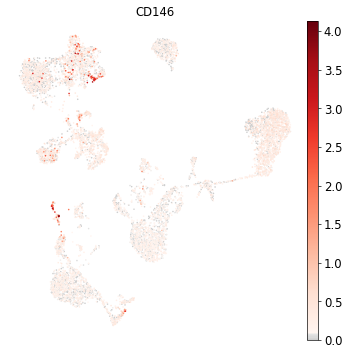

Cluster: IgM


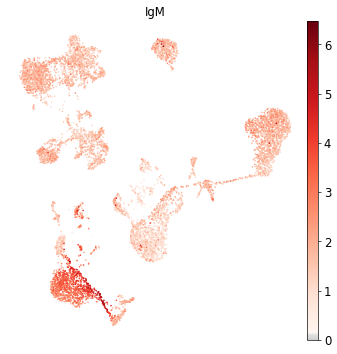

Cluster: CD5


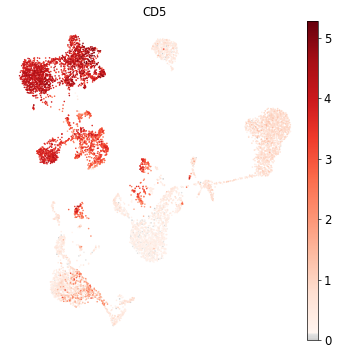

Cluster: CD195


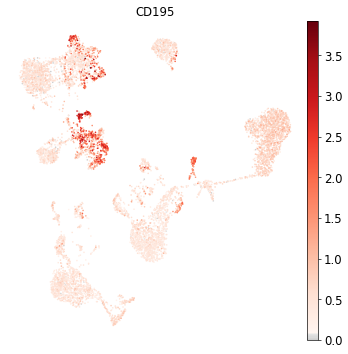

Cluster: CD32


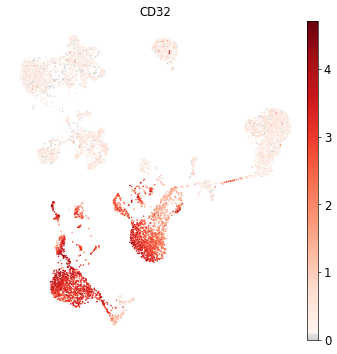

Cluster: CD196


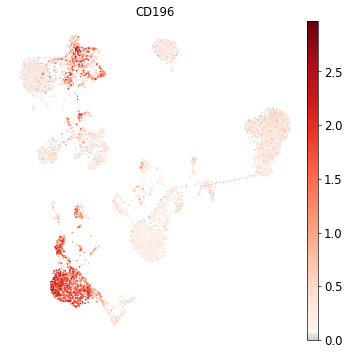

Cluster: CD185


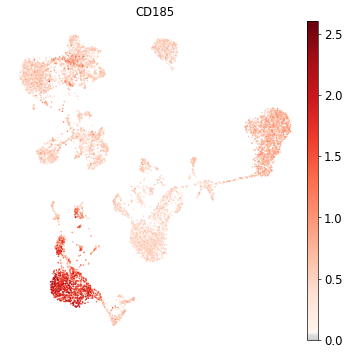

Cluster: CD103


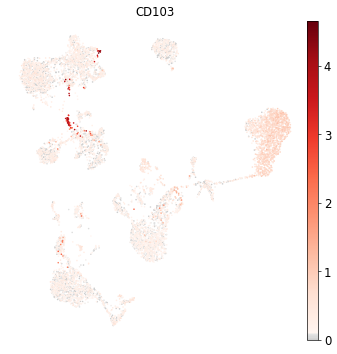

Cluster: CD69


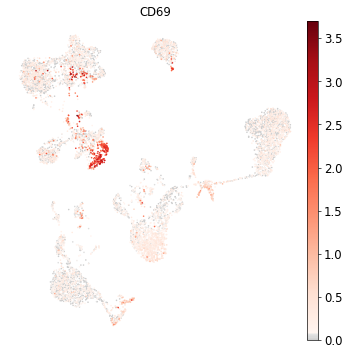

Cluster: CD62L


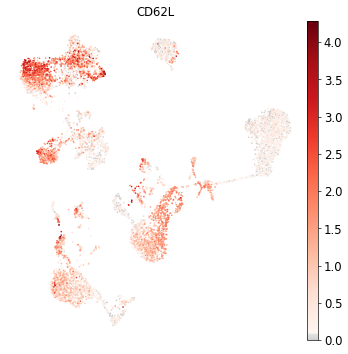

Cluster: CD161


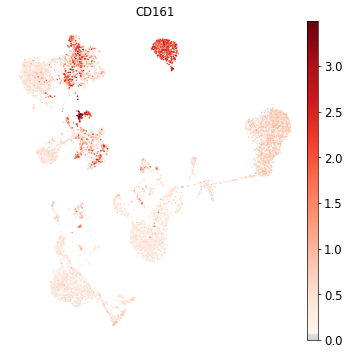

Cluster: CD152


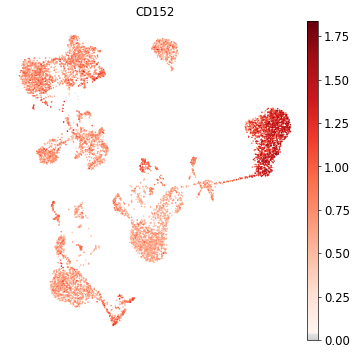

Cluster: CD223


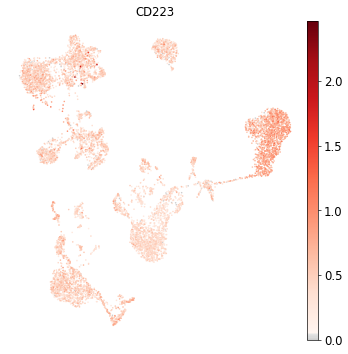

Cluster: KLRG1


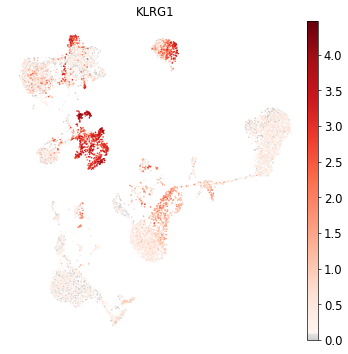

Cluster: CD27


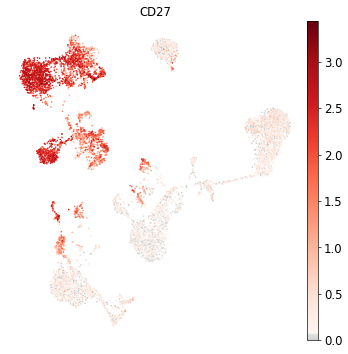

Cluster: CD107a


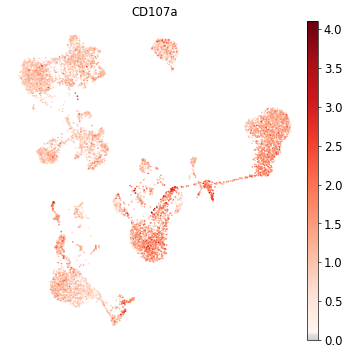

Cluster: CD95


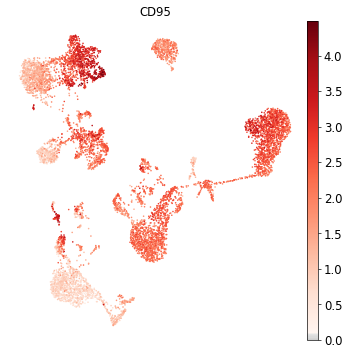

Cluster: CD134


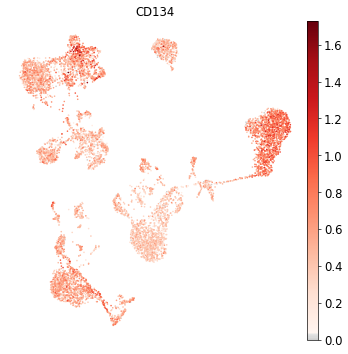

Cluster: HLA-DR


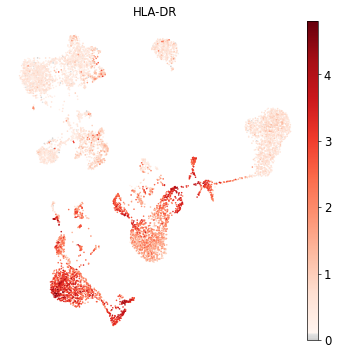

Cluster: CD1c


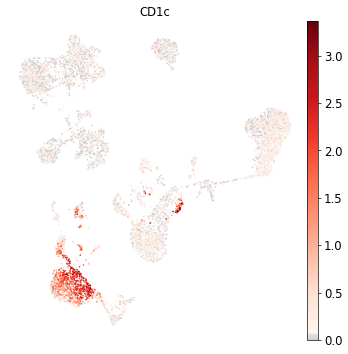

Cluster: CD11b


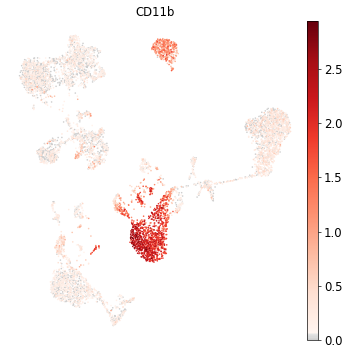

Cluster: CD64


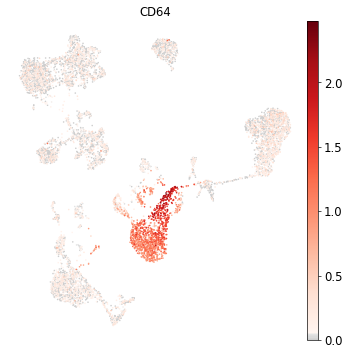

Cluster: CD141


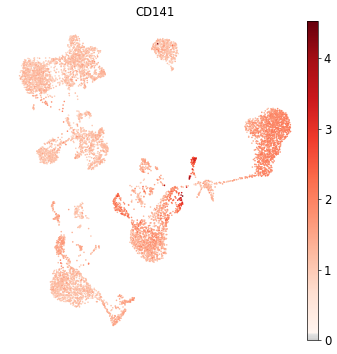

Cluster: CD1d


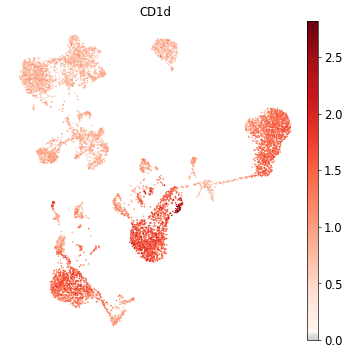

Cluster: CD314


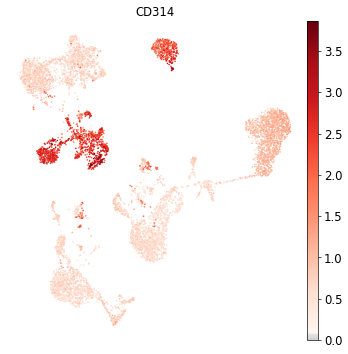

Cluster: CD35


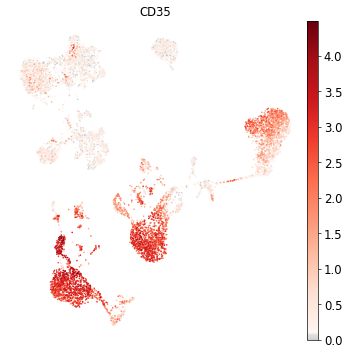

Cluster: CD57


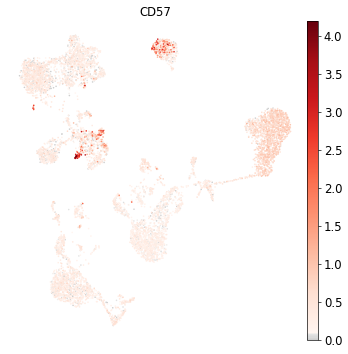

Cluster: CD272


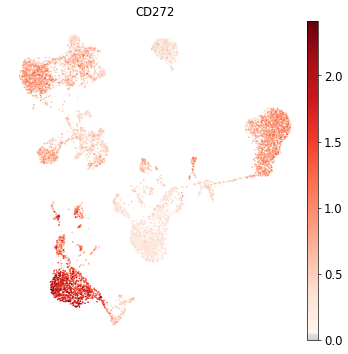

Cluster: CD278


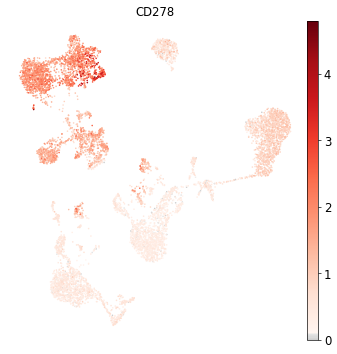

Cluster: CD58


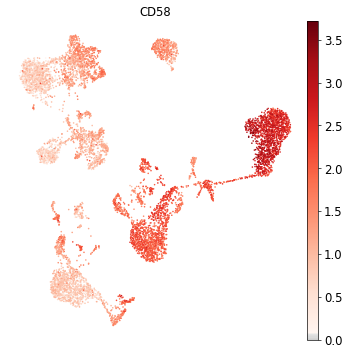

Cluster: CD39


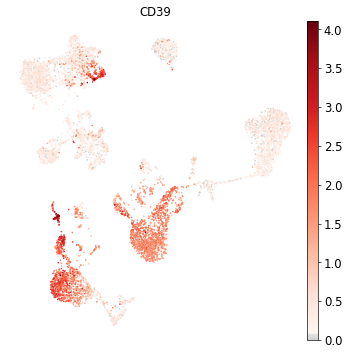

Cluster: CX3CR1


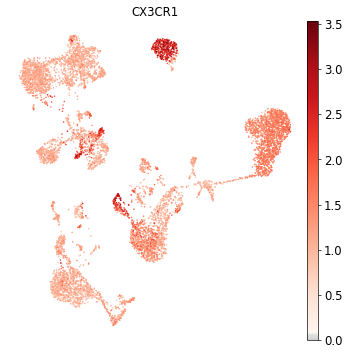

Cluster: CD24


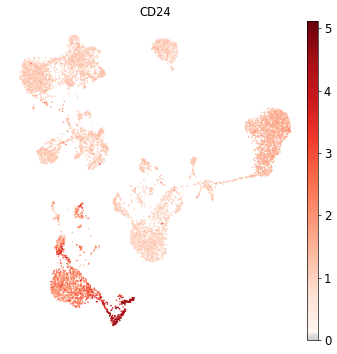

Cluster: CD21


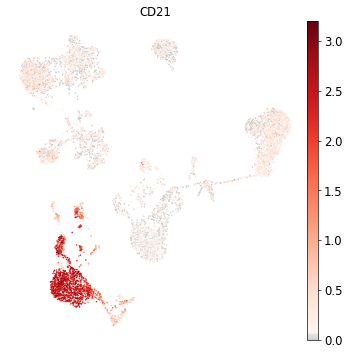

Cluster: CD11a


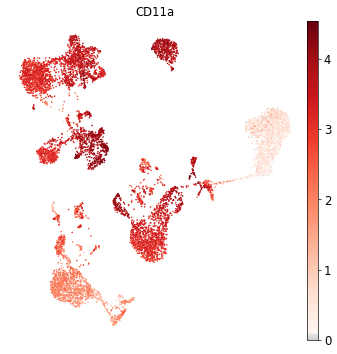

Cluster: CD79b


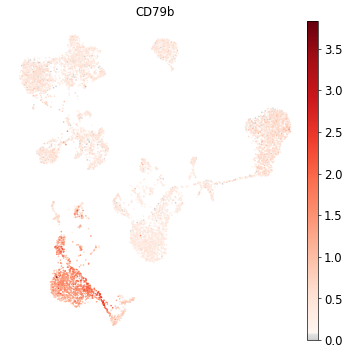

Cluster: CD244


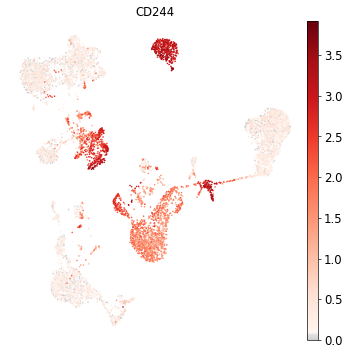

Cluster: CD169


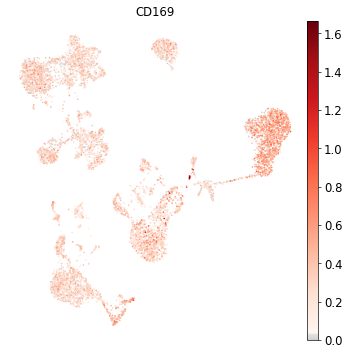

Cluster: integrinB7


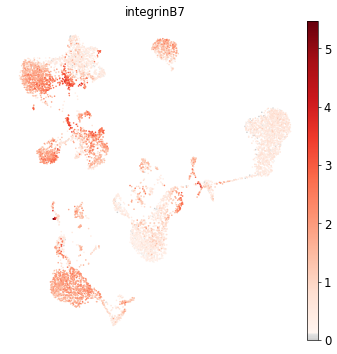

Cluster: CD268


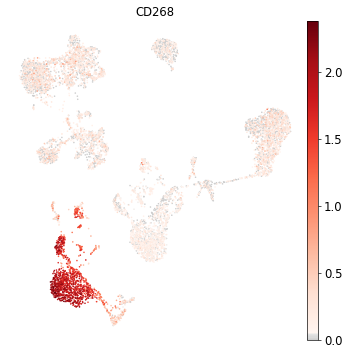

Cluster: CD42b


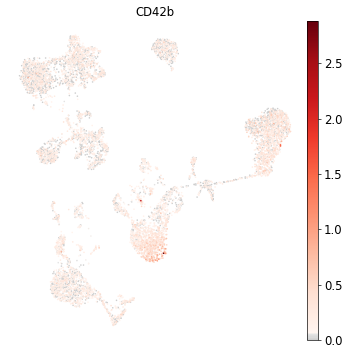

Cluster: CD54


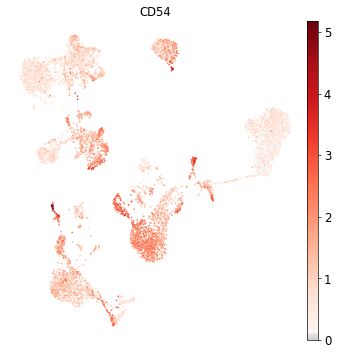

Cluster: CD62P


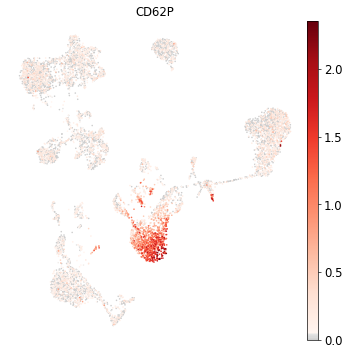

Cluster: CD119


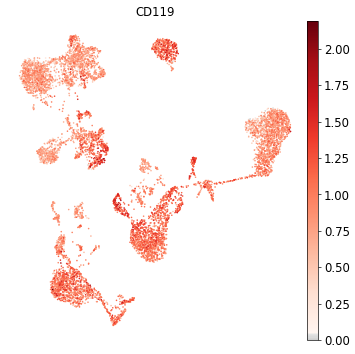

Cluster: TCR


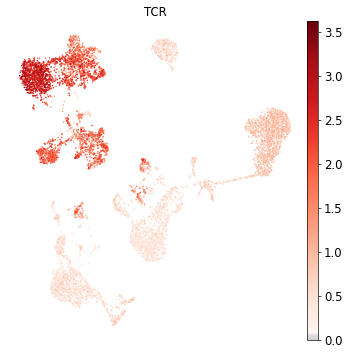

Cluster: Rat-IgG1


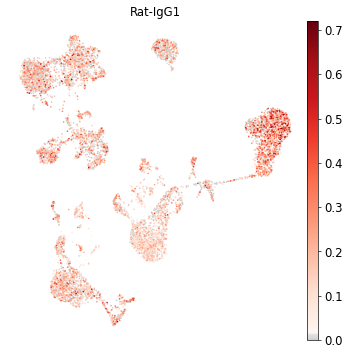

Cluster: Rat-IgG2a


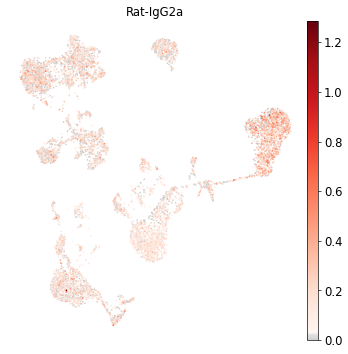

Cluster: CD192


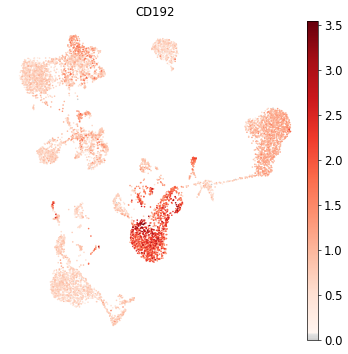

Cluster: CD122


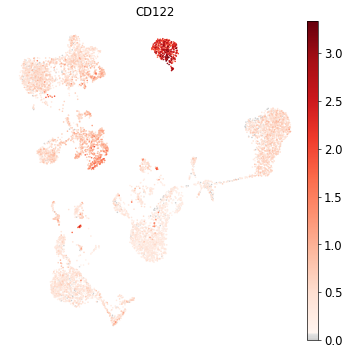

Cluster: FceRIa


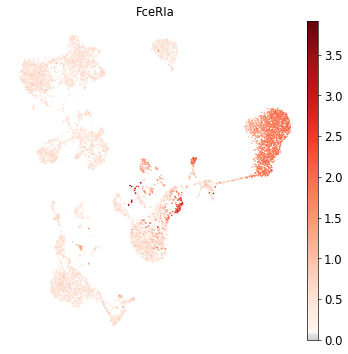

Cluster: CD41


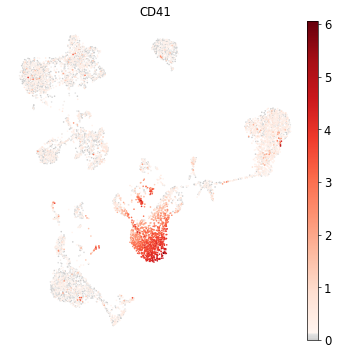

Cluster: CD137


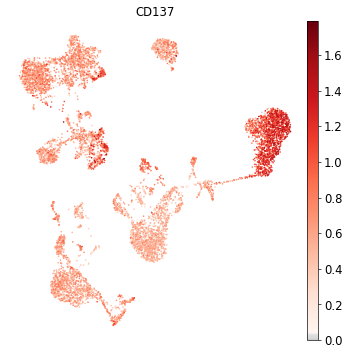

Cluster: CD163


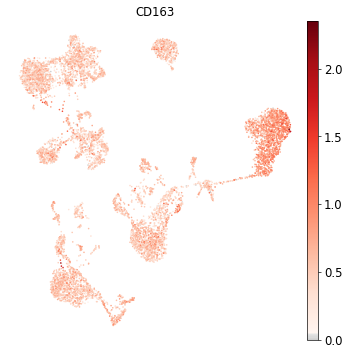

Cluster: CD83


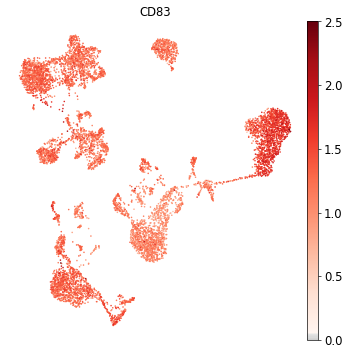

Cluster: CD124


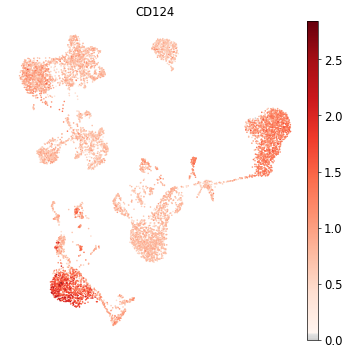

Cluster: CD13


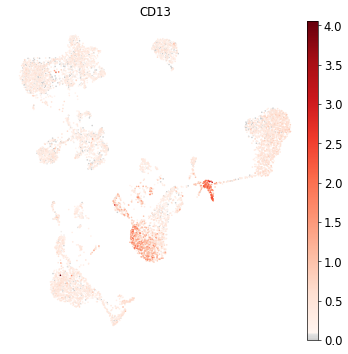

Cluster: CD2


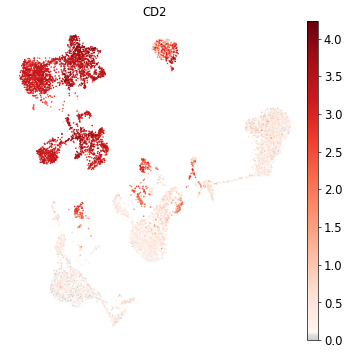

Cluster: CD226


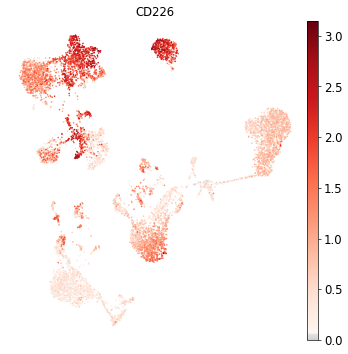

Cluster: CD29


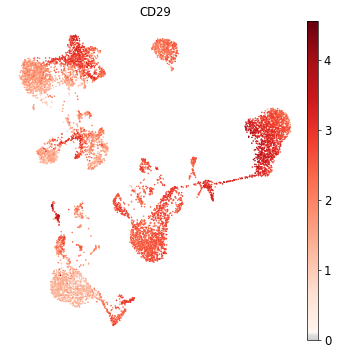

Cluster: CD303


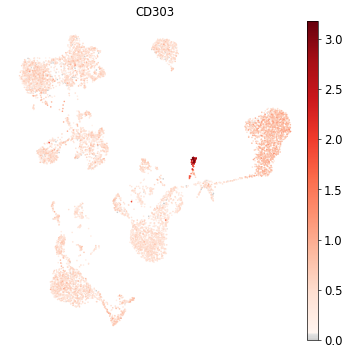

Cluster: CD49b


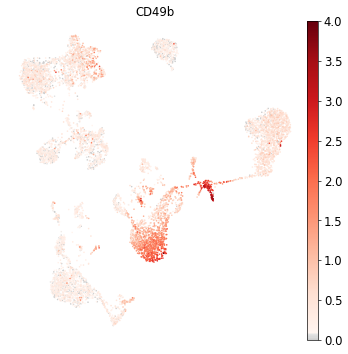

Cluster: CD81


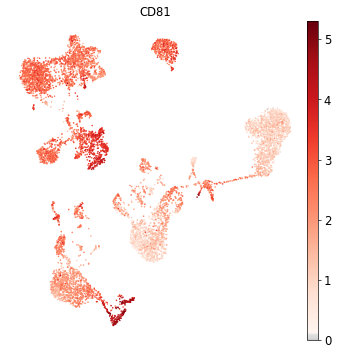

Cluster: IgD


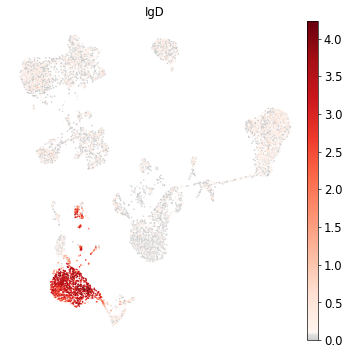

Cluster: CD18


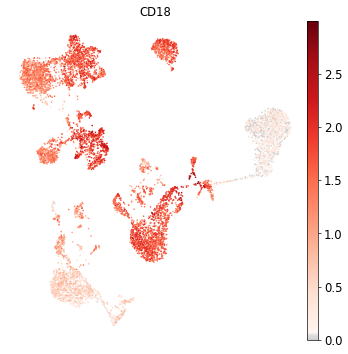

Cluster: CD28


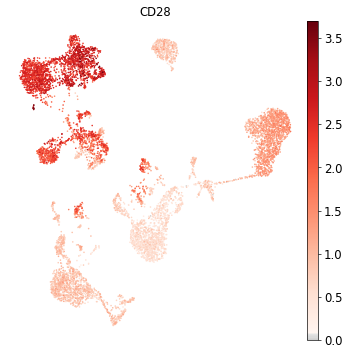

Cluster: CD38


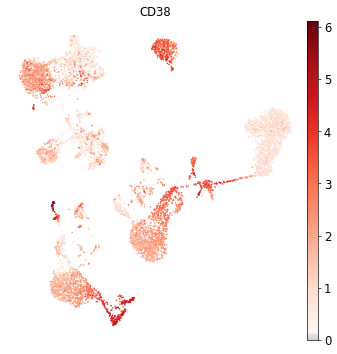

Cluster: CD127


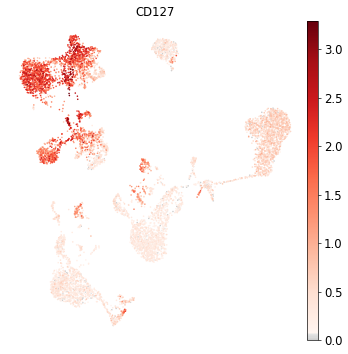

Cluster: CD45


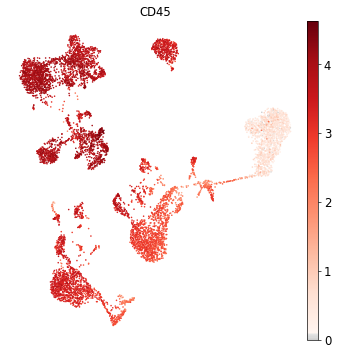

Cluster: CD22


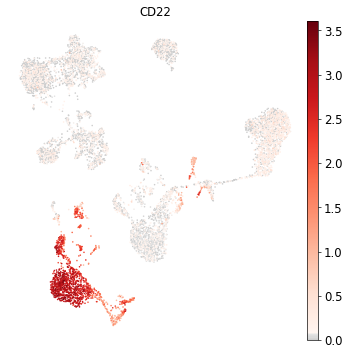

Cluster: CD71


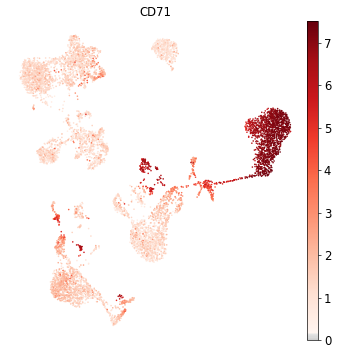

Cluster: CD26


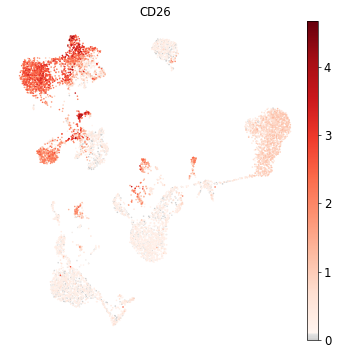

Cluster: CD115


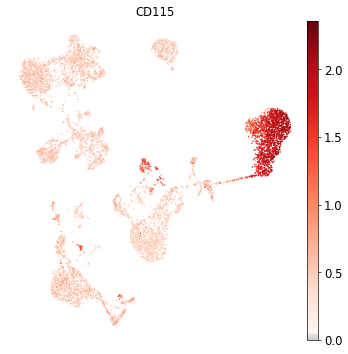

Cluster: CD63


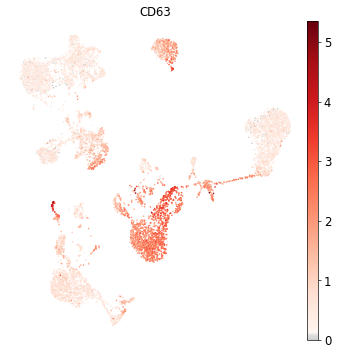

Cluster: CD304


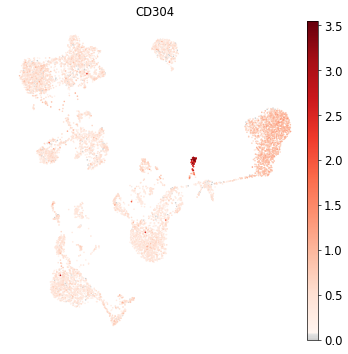

Cluster: CD36


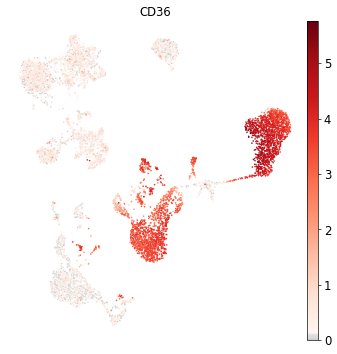

Cluster: CD172a


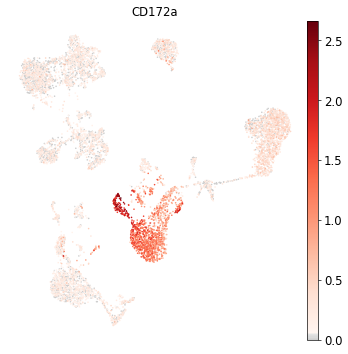

Cluster: CD72


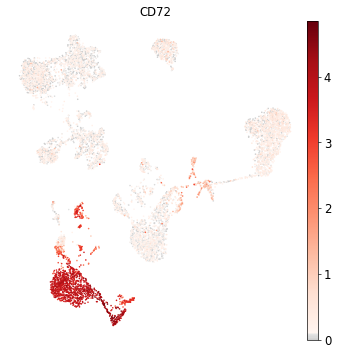

Cluster: CD158


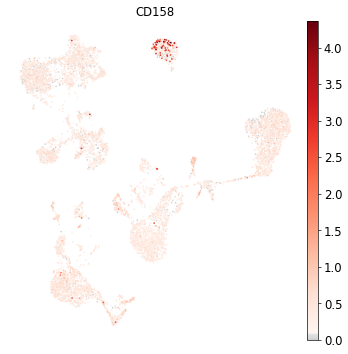

Cluster: CD93


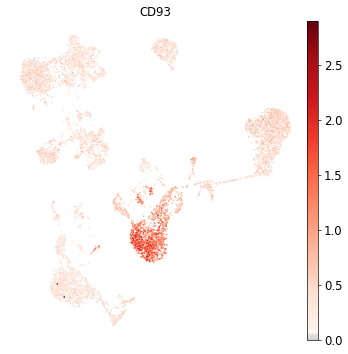

Cluster: CD49a


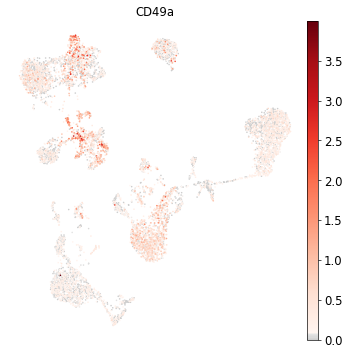

Cluster: CD49d


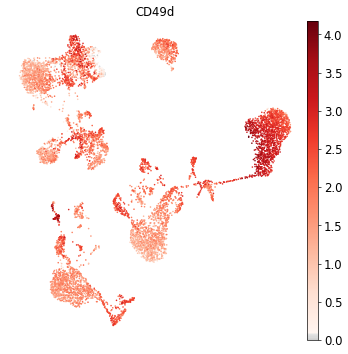

Cluster: CD73


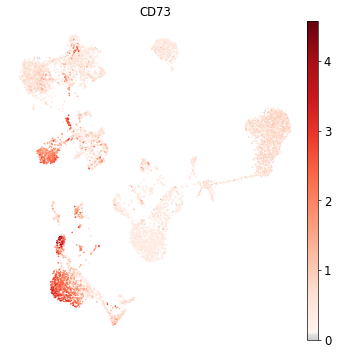

Cluster: CD9


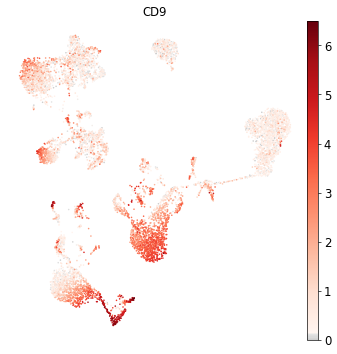

Cluster: TCRVa7.2


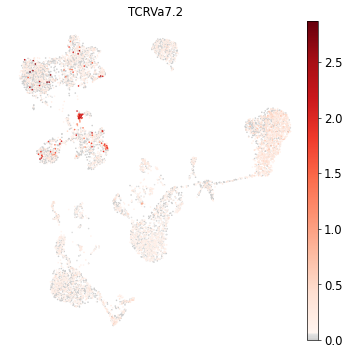

Cluster: TCRVd2


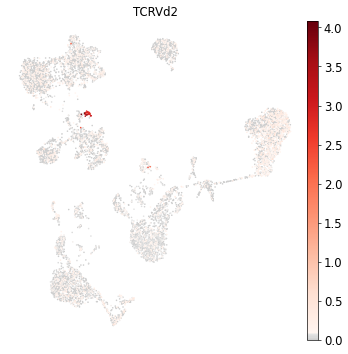

Cluster: LOX-1


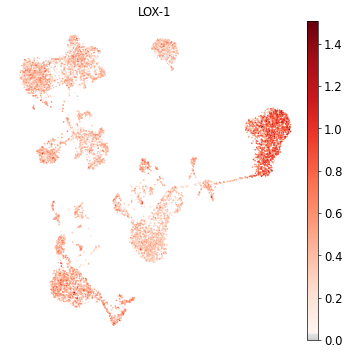

Cluster: CD158b


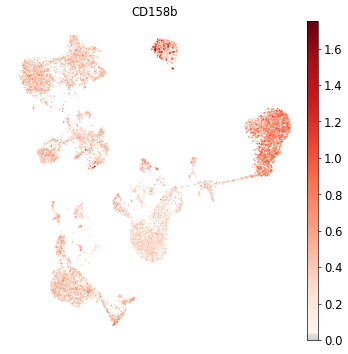

Cluster: CD158e1


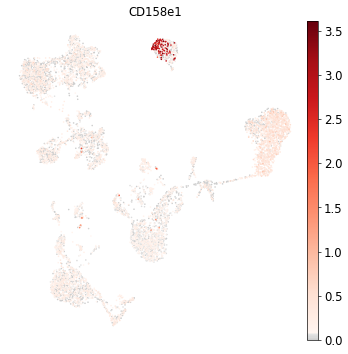

Cluster: CD142


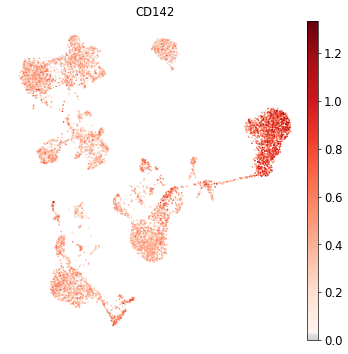

Cluster: CD319


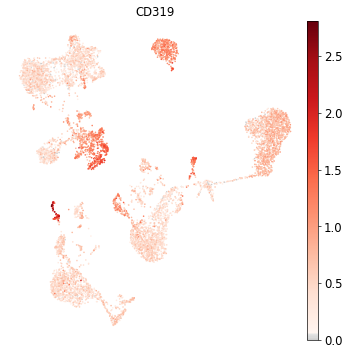

Cluster: CD352


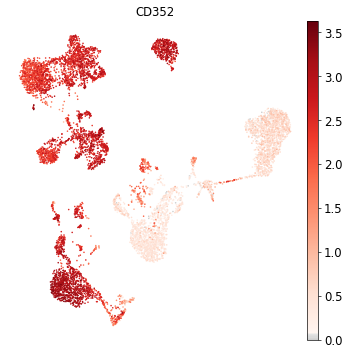

Cluster: CD94


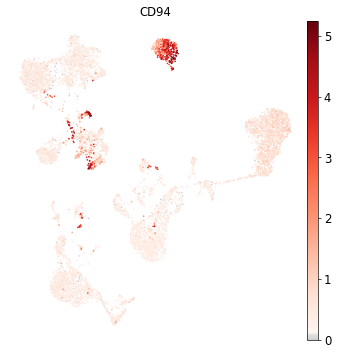

Cluster: CD162


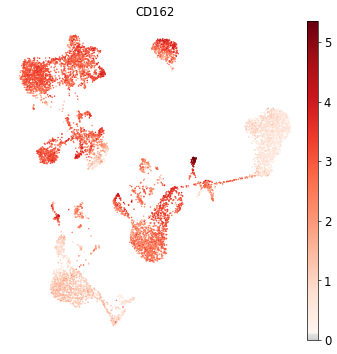

Cluster: CD85j


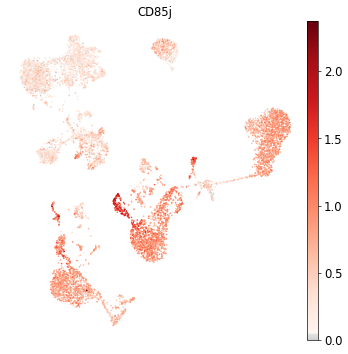

Cluster: CD23


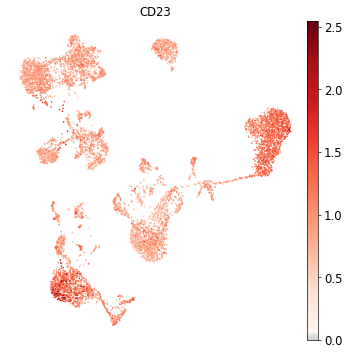

Cluster: CD328


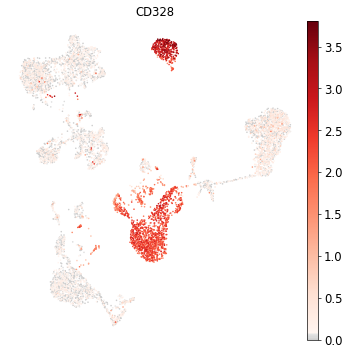

Cluster: HLA-E


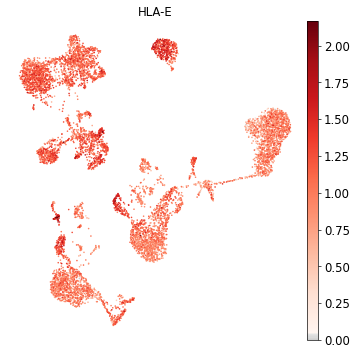

Cluster: CD82


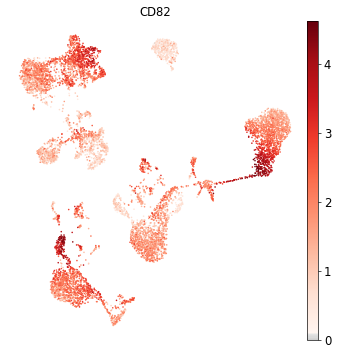

Cluster: CD101


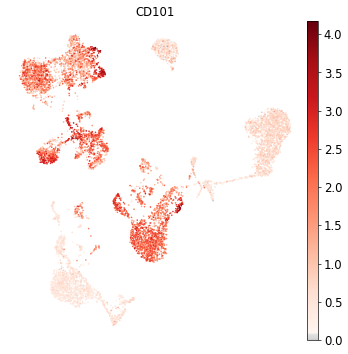

Cluster: CD88


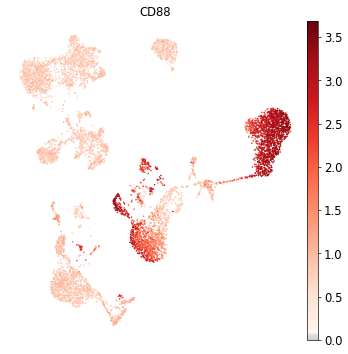

Cluster: CD224


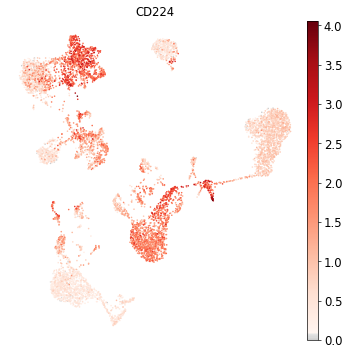

In [55]:
# Look at expression of all proteins
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)

for i in adata_adt.var_names:
    print(f'Cluster: {i}')
    if i in adata_adt.var_names:
        sc.pl.umap(adata_adt, color=i, ncols=3, use_raw=False, cmap=mymap_red)
        


In [56]:
initial_cluster_dict={
    
    '0':'Proerythroblast - Erythroblast - Normoblast/Reticulocyte',
    '1':'CD4+ T activated - Tregs',
    '2':'Naive CD20+ B',
    '3':'CD4+ T naive',
    '4':'CD14+ Mono',
    '5':'CD8+ T activated TIGIT+ - CD8+ T activated CD69+ - Lymph prog',
    '6':'NK',
    '7':'CD8+ T naive',
    '8':'cDC2 and probably doublet',
    '9':'doublet',
    '10':'Transitional B',
    '11':'B1 B',
    '12':'HSC',
    '13':'CD16+ Mono',
    '14':'doublet',
    '15':'pDCs',
    '16':'gdT - NKT',
    '17':'Plasmablast - Plasma cells',
    
}

In [57]:
adata_adt

AnnData object with n_obs × n_vars = 8455 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

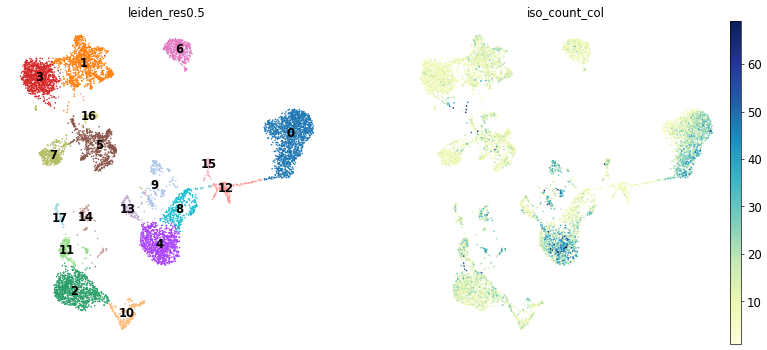

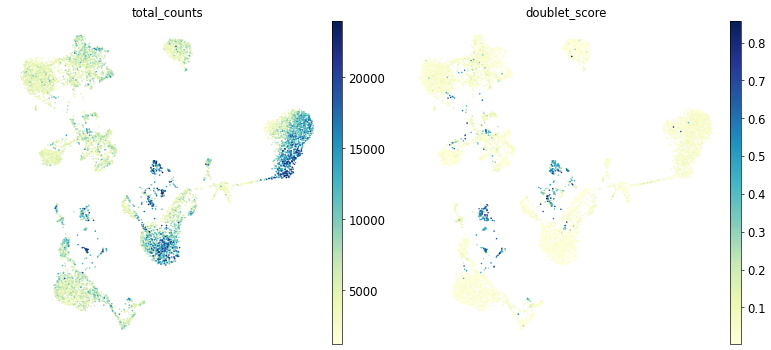

In [58]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_adt, color=[orig_res, 'iso_count_col'], legend_loc='on data')
sc.pl.umap(adata_adt, color=['total_counts', 'doublet_score'])

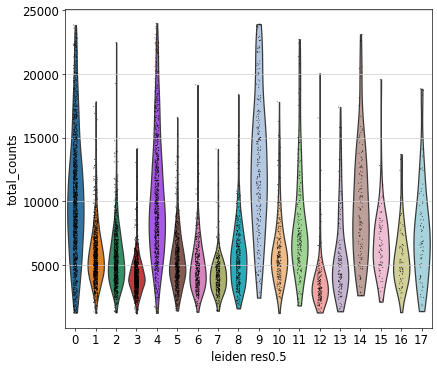

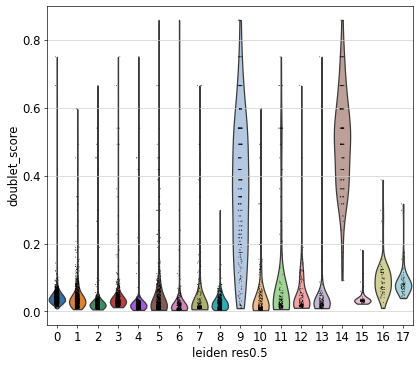

In [59]:
sc.pl.violin(adata_adt, keys='total_counts', groupby=orig_res)
sc.pl.violin(adata_adt, keys='doublet_score', groupby=orig_res)

Clusters 9 and 14 are likely doublets

# Subclustering

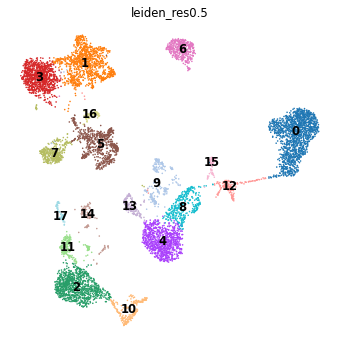

In [60]:
sc.pl.umap(adata_adt, color=orig_res, legend_loc='on data')

## Erythroid lineage

### Cluster 0 

In [149]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

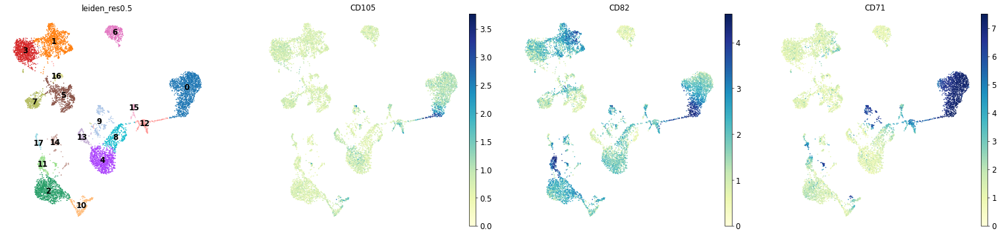

In [150]:
m_genes1 = marker_prots['Proerythroblast']
m_genes2 = marker_prots['Erythroblast']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')

In [151]:
orig_key = orig_res # only for first subclustering to generate new column
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '0'

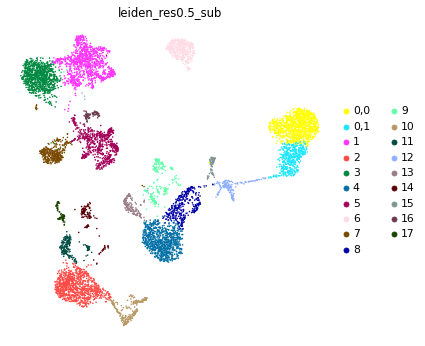

1      1061
0,0     990
2       967
3       966
4       860
5       692
0,1     458
6       418
7       369
8       360
9       235
10      229
11      192
12      166
13      140
14      130
15       79
16       74
17       69
Name: leiden_res0.5_sub, dtype: int64

In [152]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key)
adata_adt.obs[new_key].value_counts()

In [153]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '0,1'

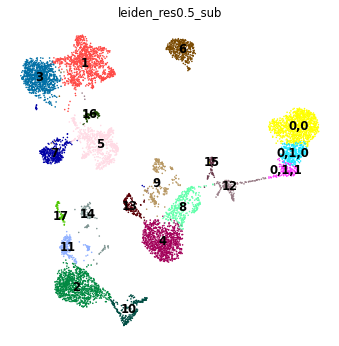

1        1061
0,0       990
2         967
3         966
4         860
5         692
6         418
7         369
8         360
0,1,0     317
9         235
10        229
11        192
12        166
0,1,1     141
13        140
14        130
15         79
16         74
17         69
Name: leiden_res0.5_sub, dtype: int64

In [154]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Summary

- Overlapping erythrocyte stages

In [155]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

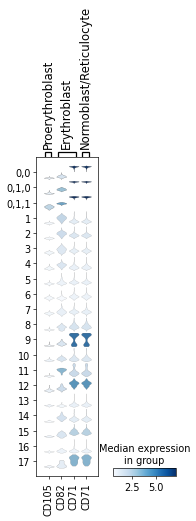

In [156]:
sc.pl.stacked_violin(adata_adt, var_names={a:marker_prots[a] for a in ['Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte']}, groupby=new_key)

## T lineage + NK

### Cluster 1

In [157]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

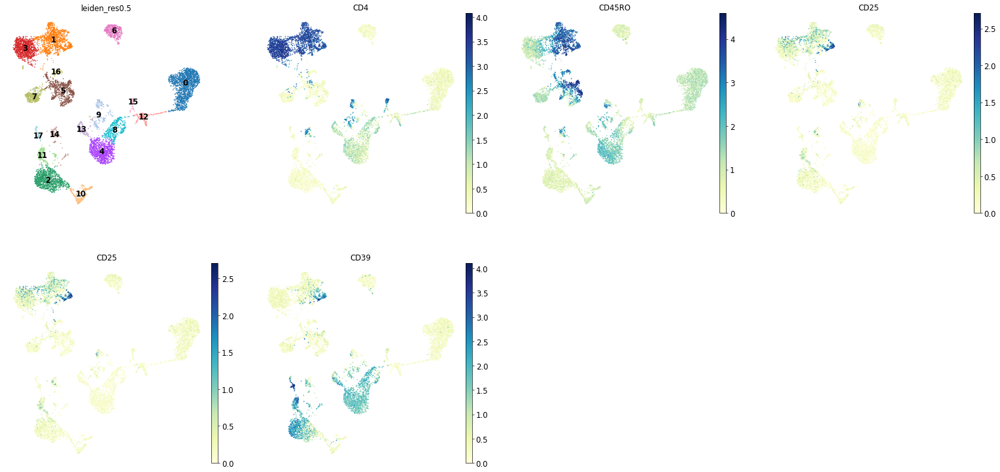

In [158]:
m_genes1 = marker_prots['CD4+ T activated']
m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')

In [159]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '1'

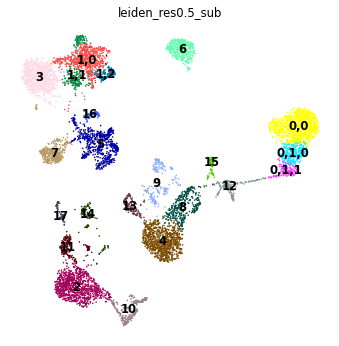

0,0      990
2        967
3        966
4        860
5        692
1,0      664
6        418
7        369
8        360
0,1,0    317
1,1      253
9        235
10       229
11       192
12       166
1,2      144
0,1,1    141
13       140
14       130
15        79
16        74
17        69
Name: leiden_res0.5_sub, dtype: int64

In [160]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 3

In [161]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

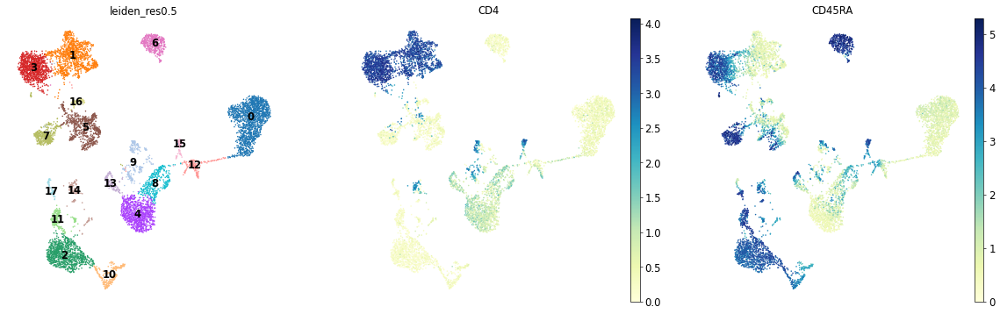

In [162]:
#m_genes1 = marker_prots['CD4+ T activated']
m_genes2 = marker_prots['CD4+ T naive']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes2, legend_loc = 'on data')

### Cluster 5

In [163]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

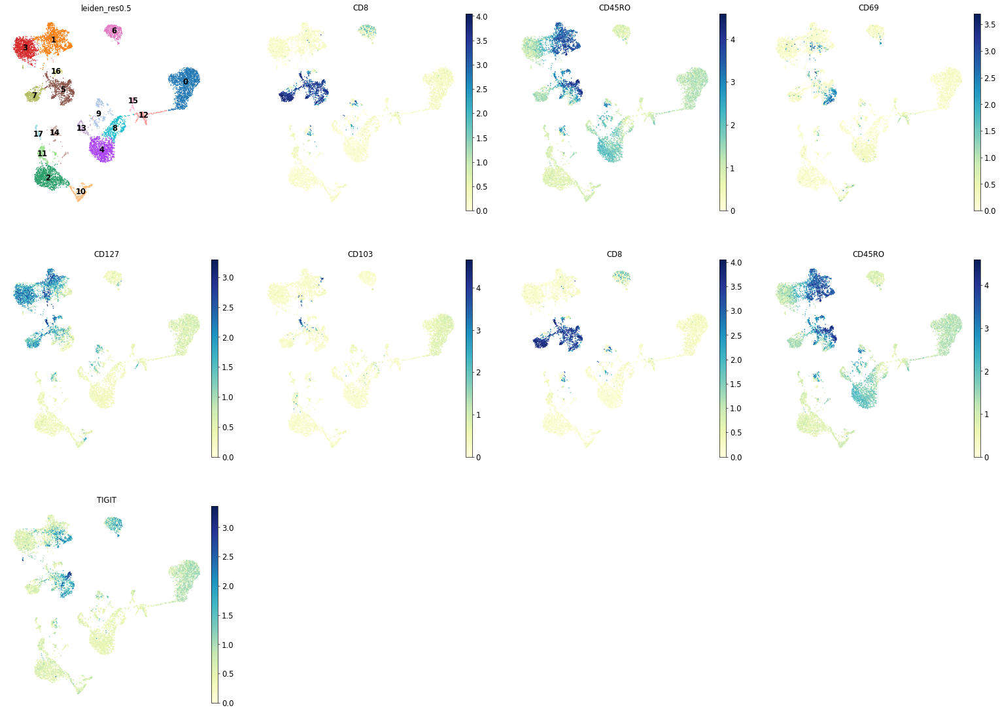

In [164]:
m_genes1 = marker_prots['CD8+ T activated CD69+']
m_genes2 = marker_prots['ILC']
m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2+m_genes3, legend_loc = 'on data')

In [165]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '5'

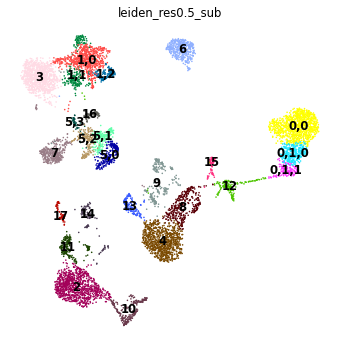

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
8        360
0,1,0    317
1,1      253
5,0      241
9        235
10       229
5,1      217
11       192
5,2      189
12       166
1,2      144
0,1,1    141
13       140
14       130
15        79
16        74
17        69
5,3       45
Name: leiden_res0.5_sub, dtype: int64

In [166]:
res = 0.25
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 7

In [167]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

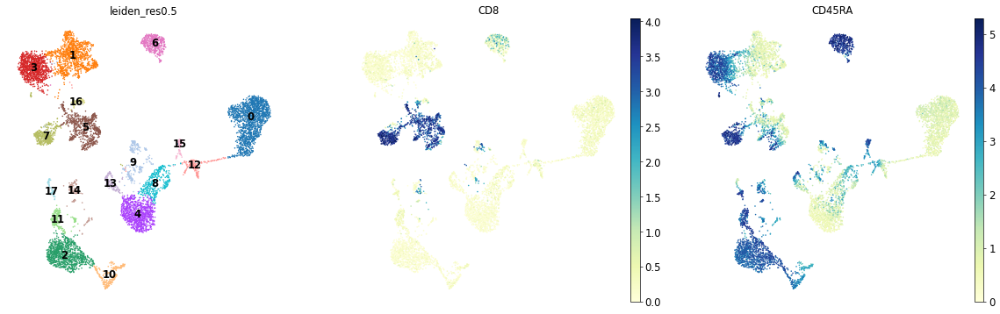

In [168]:
m_genes1 = marker_prots['CD8+ T naive']
#m_genes2 = marker_prots['ILC']
#m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2+m_genes3

### Cluster 16

In [169]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

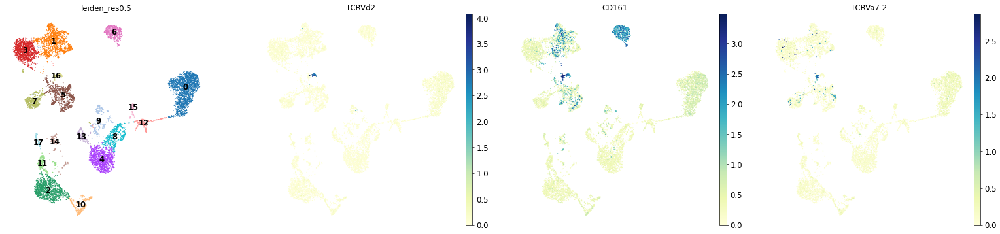

In [170]:
m_genes1 = marker_prots['gdT']
m_genes2 = marker_prots['NKT']
#m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')#+m_genes2+m_genes3

In [171]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '16'

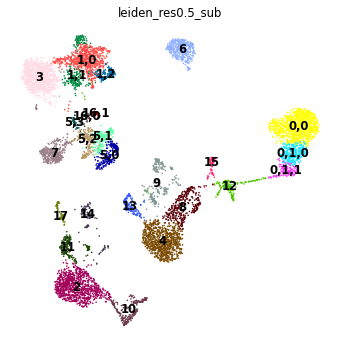

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
8        360
0,1,0    317
1,1      253
5,0      241
9        235
10       229
5,1      217
11       192
5,2      189
12       166
1,2      144
0,1,1    141
13       140
14       130
15        79
17        69
5,3       45
16,0      37
16,1      37
Name: leiden_res0.5_sub, dtype: int64

In [172]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 6

In [173]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

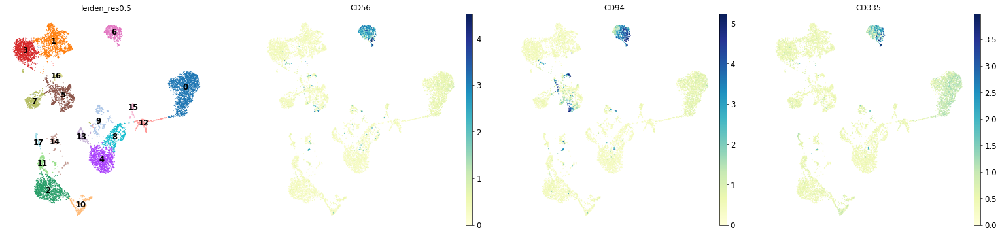

In [174]:
m_genes1 = marker_prots['NK']
#m_genes2 = marker_prots['NKT']
#m_genes3 = marker_prots['CD8+ T activated TIGIT+']

sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2+m_genes3

### Summary

- Overlapping erythrocyte stages

In [175]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

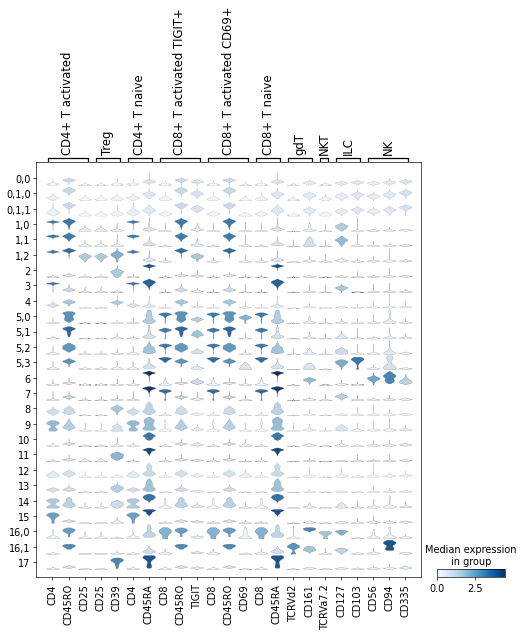

In [176]:
sc.pl.stacked_violin(adata_adt, var_names={a:marker_prots[a] for a in ['CD4+ T activated',
                                                                      'Treg',
                                                                      'CD4+ T naive',
                                                                      'CD8+ T activated TIGIT+',
                                                                      'CD8+ T activated CD69+',
                                                                      'CD8+ T naive',
                                                                      'gdT','NKT','ILC', 'NK']}, groupby=new_key)

## B lineage

### Cluster 2

In [177]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

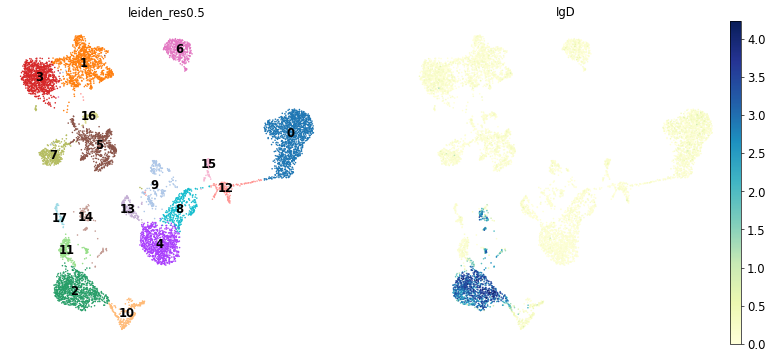

In [178]:
m_genes1 = marker_prots['Naive CD20+ B']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

### Cluster 10

In [180]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

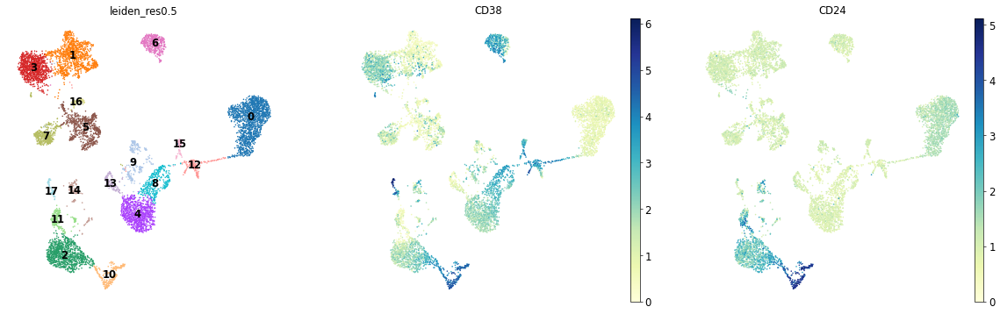

In [92]:
m_genes1 = marker_prots['Transitional B']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

In [186]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '10'

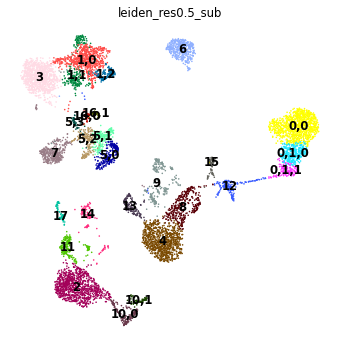

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
8        360
0,1,0    317
1,1      253
5,0      241
9        235
5,1      217
11       192
5,2      189
12       166
10,0     156
1,2      144
0,1,1    141
13       140
14       130
15        79
10,1      73
17        69
5,3       45
16,0      37
16,1      37
Name: leiden_res0.5_sub, dtype: int64

In [187]:
res = 0.1
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 11

In [191]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

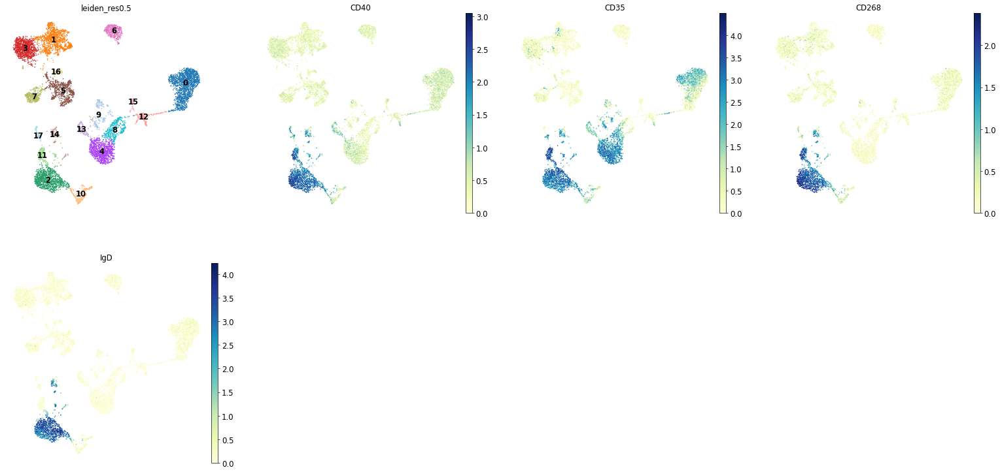

In [192]:
m_genes1 = marker_prots['B1 B']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

In [193]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '11'

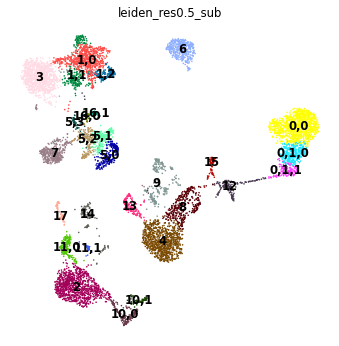

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
8        360
0,1,0    317
1,1      253
5,0      241
9        235
5,1      217
5,2      189
12       166
11,0     160
10,0     156
1,2      144
0,1,1    141
13       140
14       130
15        79
10,1      73
17        69
5,3       45
16,0      37
16,1      37
11,1      32
Name: leiden_res0.5_sub, dtype: int64

In [194]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 17

In [195]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

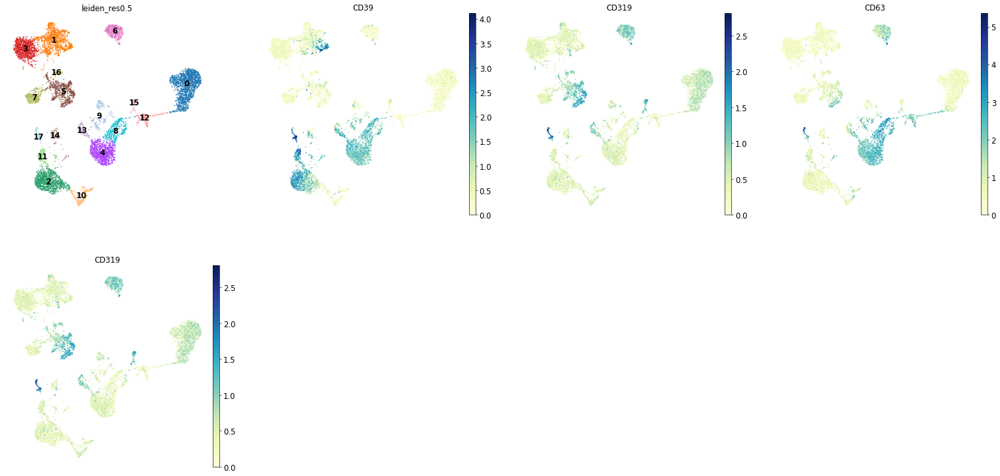

In [196]:
m_genes1 = marker_prots['Plasmablast']
m_genes2 = marker_prots['Plasma cells']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1+m_genes2, legend_loc = 'on data')#+m_genes2

In [197]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '17'

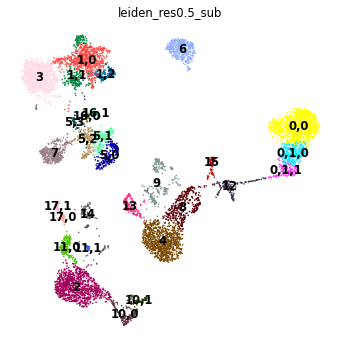

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
8        360
0,1,0    317
1,1      253
5,0      241
9        235
5,1      217
5,2      189
12       166
11,0     160
10,0     156
1,2      144
0,1,1    141
13       140
14       130
15        79
10,1      73
17,0      46
5,3       45
16,0      37
16,1      37
11,1      32
17,1      23
Name: leiden_res0.5_sub, dtype: int64

In [198]:
res = 0.2
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

## Mono / DCs

### Cluster 4

In [199]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

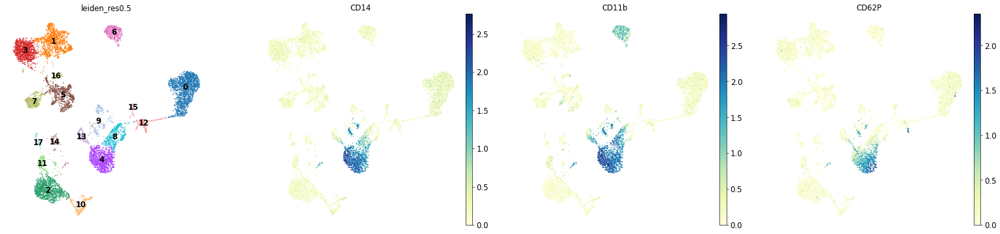

In [200]:
m_genes1 = marker_prots['CD14+ Mono']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

### Cluster 8

In [201]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

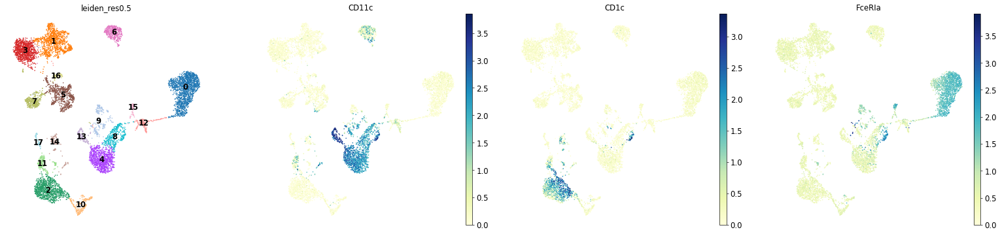

In [202]:
m_genes1 = marker_prots['cDC2']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

In [203]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '8'

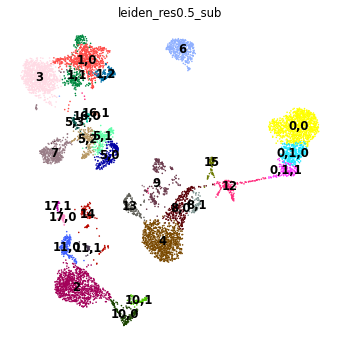

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
0,1,0    317
8,0      288
1,1      253
5,0      241
9        235
5,1      217
5,2      189
12       166
11,0     160
10,0     156
1,2      144
0,1,1    141
13       140
14       130
15        79
10,1      73
8,1       72
17,0      46
5,3       45
16,0      37
16,1      37
11,1      32
17,1      23
Name: leiden_res0.5_sub, dtype: int64

In [204]:
res = 0.1
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

### Cluster 13

In [205]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

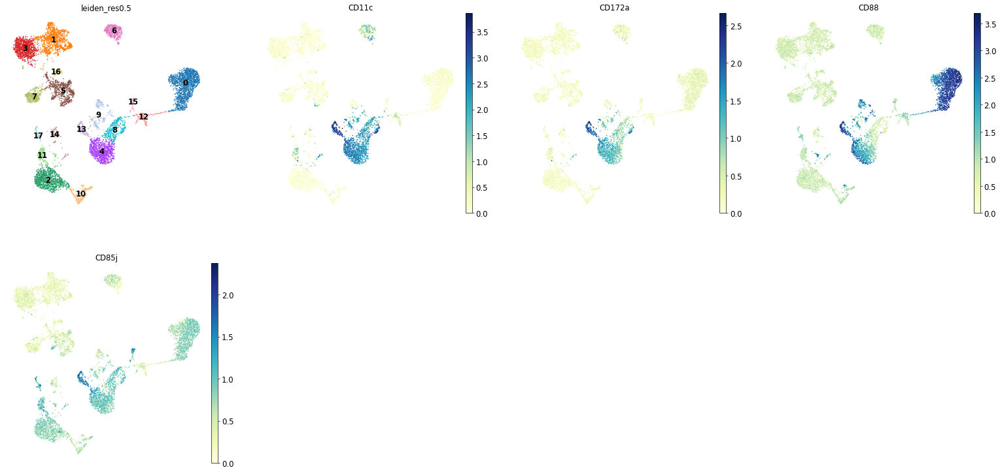

In [206]:
m_genes1 = marker_prots['CD16+ Mono']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

### Cluster 15

In [207]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

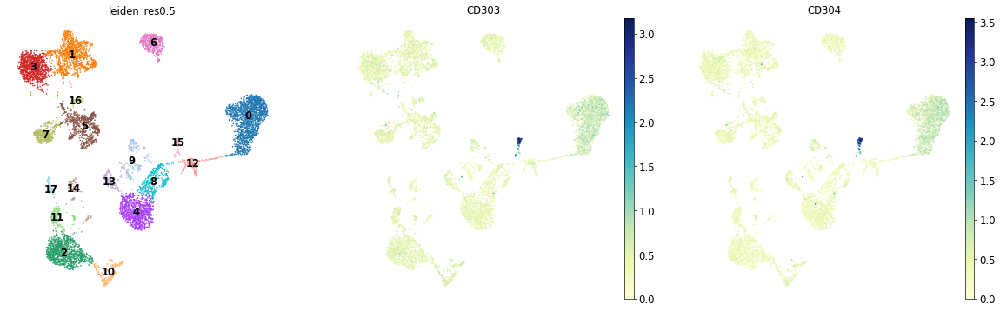

In [208]:
m_genes1 = marker_prots['pDCs']
#m_genes2 = marker_prots['Treg']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes1, legend_loc = 'on data')#+m_genes2

## Stem

### Cluster 12

In [209]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'HSC', 'Lymph prog', 'G/M prog'])

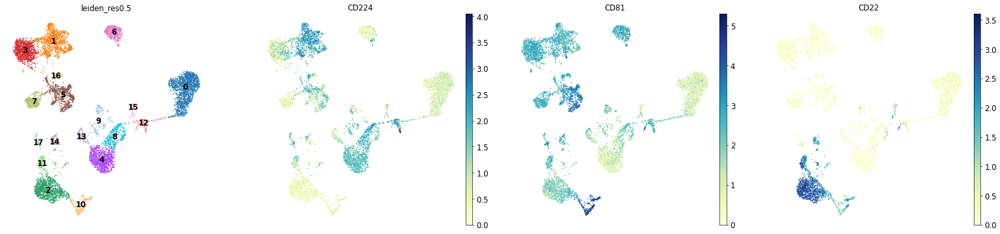

In [210]:
#m_genes1 = marker_prots['HSC (MK/E G/M) prog']
m_genes2 = marker_prots['Lymph prog']
#m_genes3 = marker_prots['G/M prog']
sc.pl.umap(adata_adt, color=[orig_res]+m_genes2, legend_loc = 'on data')

In [211]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '12'

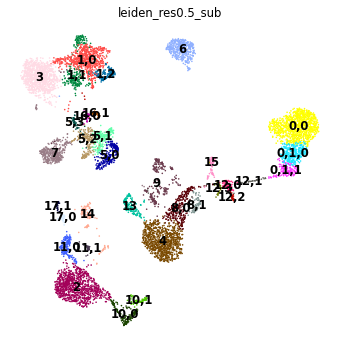

0,0      990
2        967
3        966
4        860
1,0      664
6        418
7        369
0,1,0    317
8,0      288
1,1      253
5,0      241
9        235
5,1      217
5,2      189
11,0     160
10,0     156
1,2      144
0,1,1    141
13       140
14       130
15        79
12,0      76
10,1      73
8,1       72
17,0      46
5,3       45
16,0      37
16,1      37
12,1      36
11,1      32
12,2      31
12,3      23
17,1      23
Name: leiden_res0.5_sub, dtype: int64

In [212]:
res = 0.3
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

In [243]:
orig_key = 'leiden_res0.5_sub' 
new_key = 'leiden_res0.5_sub'
#new_key = 'leiden_temp'
new_rg_key = 'rg_res0.5_sub'
sub_key = '12,3'

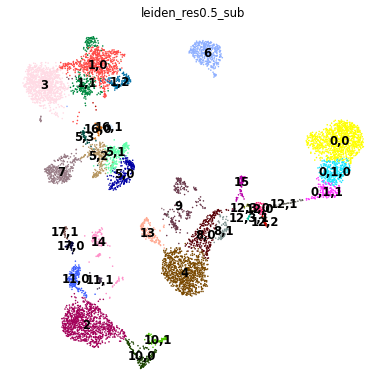

0,0       990
2         967
3         966
4         860
1,0       664
6         418
7         369
0,1,0     317
8,0       288
1,1       253
5,0       241
9         235
5,1       217
5,2       189
11,0      160
10,0      156
1,2       144
0,1,1     141
13        140
14        130
15         79
12,0       76
10,1       73
8,1        72
17,0       46
5,3        45
16,1       37
16,0       37
12,1       36
11,1       32
12,2       31
17,1       23
12,3,0     13
12,3,1     10
Name: leiden_res0.5_sub, dtype: int64

In [244]:
res = 0.3
sc.tl.leiden(adata_adt, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_adt, color=new_key, legend_loc = 'on data')
adata_adt.obs[new_key].value_counts()

## Cluster dictionary

In [245]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog'])

In [246]:
rename_clust_dict = {
    
    '0,0':'Normoblast/Reticulocyte', # Potentially cluster to left is Reticulocyte, rest Normoblast
    '0,1,0':'Erythroblast',
    '0,1,1':'Proerythroblast',
    '1,0':'CD4+ T activated',
    '1,1':'CD4 activated other (doublet?)',
    '1,2':'Treg',
    '2':'Naive CD20+ B',
    '3':'CD4+ T naive',
    '4':'CD14+ Mono',
    '5,0':'CD8+ T activated CD69+',
    '5,1':'CD8+ T activated TIGIT+',
    '5,2':'CD8+ T activated other', # more specific?
    '5,3':'ILC',
    '6':'NK',
    '7':'CD8+ T naive',
    '8,0':'pot doublet',
    '8,1':'cDC2',
    '9':'doublet',
    '10,0':'Transitional B - 1',
    '10,1':'Transitional B - CD31+ (doublet?)',
    '11,0':'B1 B - 1',
    '11,1':'B1 B - 2 (doublet?)',
    '12,0':'HSC',
    '12,1':'MK/E prog',
    '12,2':'HSC',
    '12,3,0':'G/M prog',
    '12,3,1':'Lymph prog',
    '13':'CD16+ Mono',
    '14':'doublet',
    '15':'pDCs',
    '16,0':'NKT', # not 100% sure
    '16,1':'gdT',
    '17,0':'Plasmablast',
    '17,1':'Plasma cells'

    
}

In [247]:
adata_adt.obs['leiden_final'] = adata_adt.obs['leiden_res0.5_sub'].map(rename_clust_dict)

In [248]:
adata_adt.obs['leiden_final'].value_counts()

Normoblast/Reticulocyte              990
Naive CD20+ B                        967
CD4+ T naive                         966
CD14+ Mono                           860
CD4+ T activated                     664
NK                                   418
CD8+ T naive                         369
doublet                              365
Erythroblast                         317
pot doublet                          288
CD4 activated other (doublet?)       253
CD8+ T activated CD69+               241
CD8+ T activated TIGIT+              217
CD8+ T activated other               189
B1 B - 1                             160
Transitional B - 1                   156
Treg                                 144
Proerythroblast                      141
CD16+ Mono                           140
HSC                                  107
pDCs                                  79
Transitional B - CD31+ (doublet?)     73
cDC2                                  72
Plasmablast                           46
ILC             

In [249]:
adata_adt

AnnData object with n_obs × n_vars = 8455 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_sub', 'rna_labels', 'leiden_temp', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'rna_labels_colors', 'rg_res0.5_sub', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
 

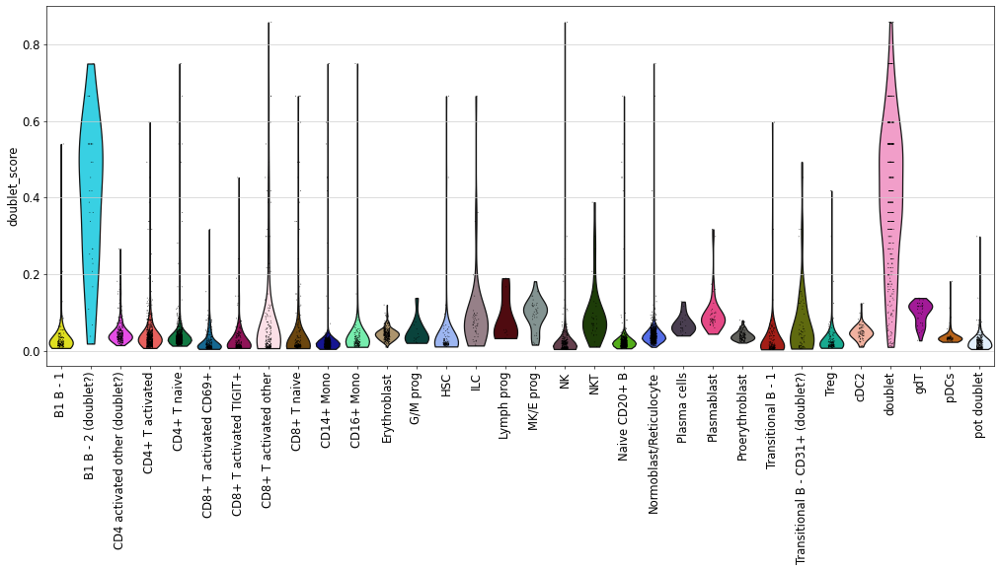

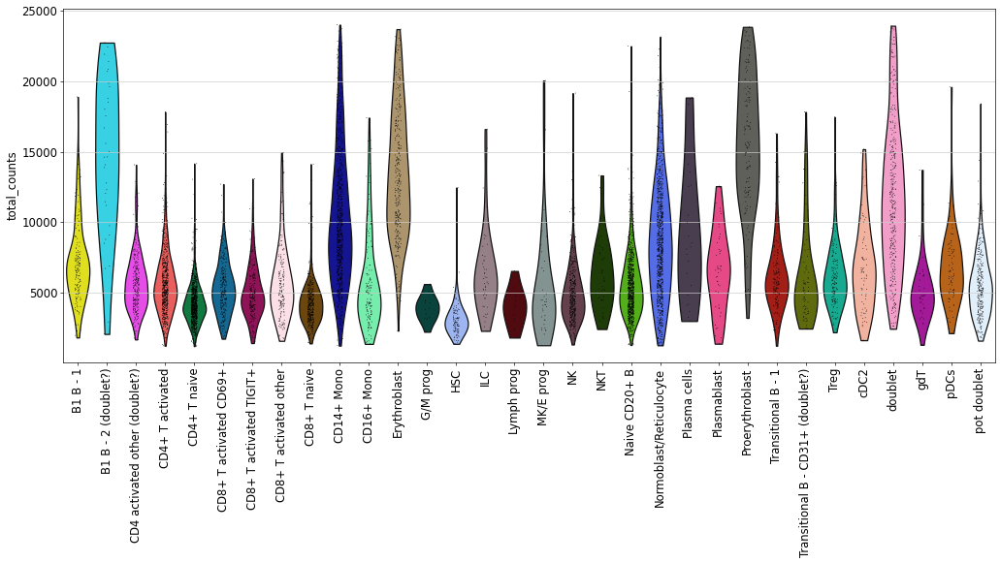

In [258]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_adt, keys='doublet_score', groupby='leiden_final', rotation=90)
sc.pl.violin(adata_adt, keys='total_counts', groupby='leiden_final', rotation=90)
plt.rcParams['figure.figsize']=(7,7)


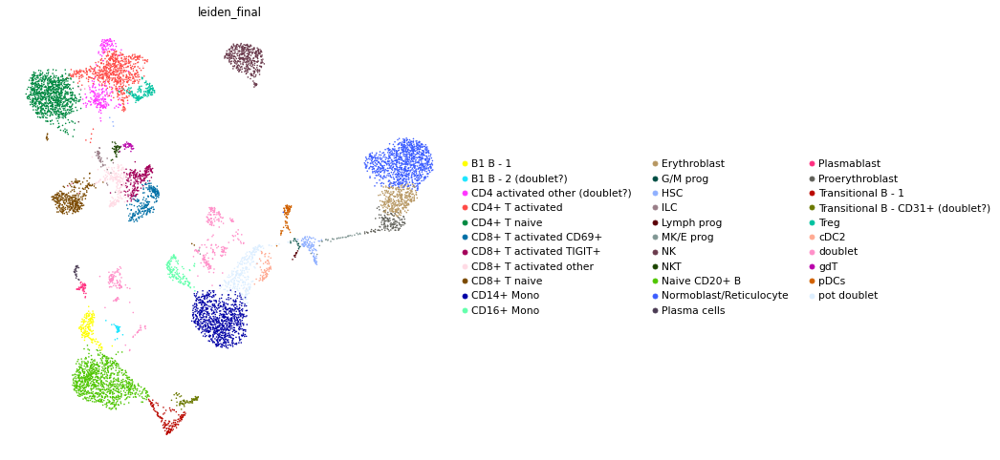

In [259]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_adt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

## Doublet filtering

In [260]:
adata_adt.obs['leiden_final'].value_counts()

Normoblast/Reticulocyte              990
Naive CD20+ B                        967
CD4+ T naive                         966
CD14+ Mono                           860
CD4+ T activated                     664
NK                                   418
CD8+ T naive                         369
doublet                              365
Erythroblast                         317
pot doublet                          288
CD4 activated other (doublet?)       253
CD8+ T activated CD69+               241
CD8+ T activated TIGIT+              217
CD8+ T activated other               189
B1 B - 1                             160
Transitional B - 1                   156
Treg                                 144
Proerythroblast                      141
CD16+ Mono                           140
HSC                                  107
pDCs                                  79
Transitional B - CD31+ (doublet?)     73
cDC2                                  72
Plasmablast                           46
ILC             

In [261]:
print((32+365)/8455)  # B1 B - 2 (doublet?) + doublet
print((32+365 + 288)/8455)  # B1 B - 2 (doublet?) + doublet + pot doublet 

0.04695446481371969
0.08101714961561206


In [262]:
adata_adt_filt = adata_adt[[c not in ['doublet', 'B1 B - 2 (doublet?)'] for c in adata_adt.obs['leiden_final']],:]

In [263]:
adata_adt_filt

View of AnnData object with n_obs × n_vars = 8058 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_sub', 'rna_labels', 'leiden_temp', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'rg_res0.5_sub', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs

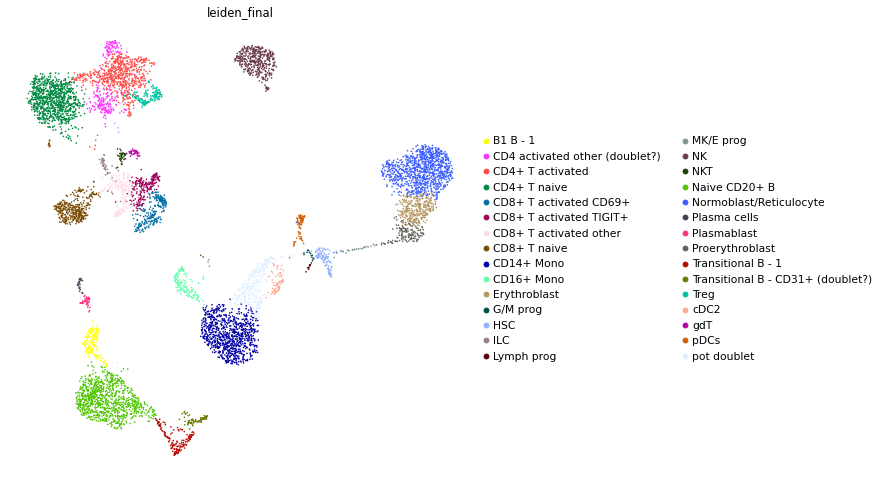

In [264]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_adt_filt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

# Marker overview

In [265]:
marker_prots.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs', 'Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC', 'MK/E prog', 'HSC', 'Lymph prog', 'G/M prog'])

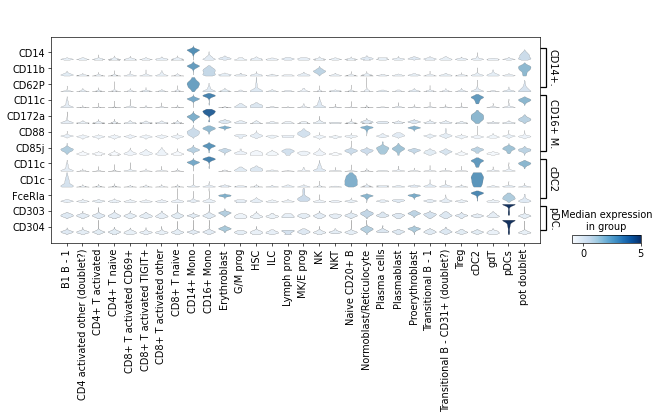

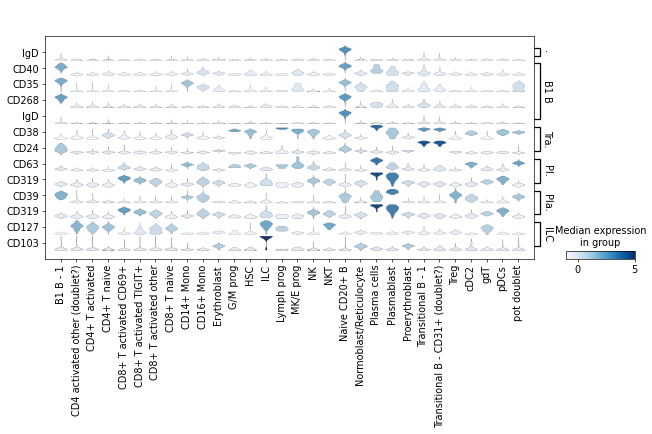

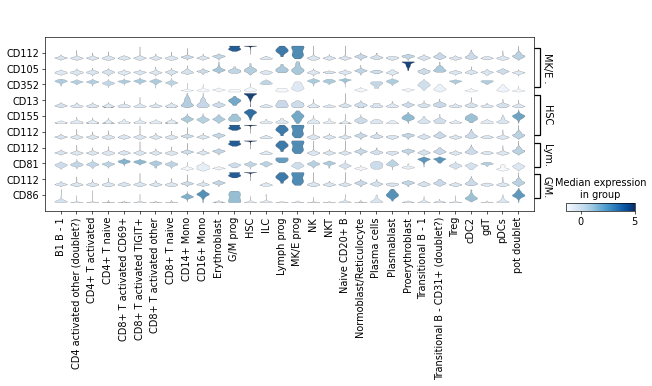

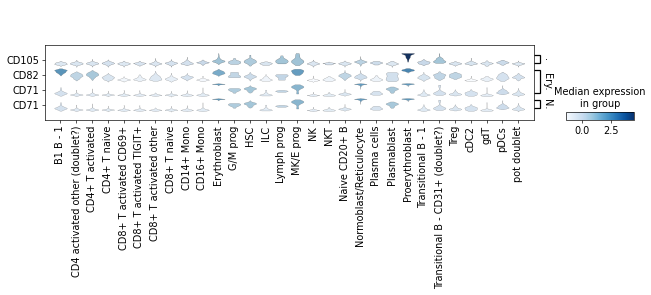

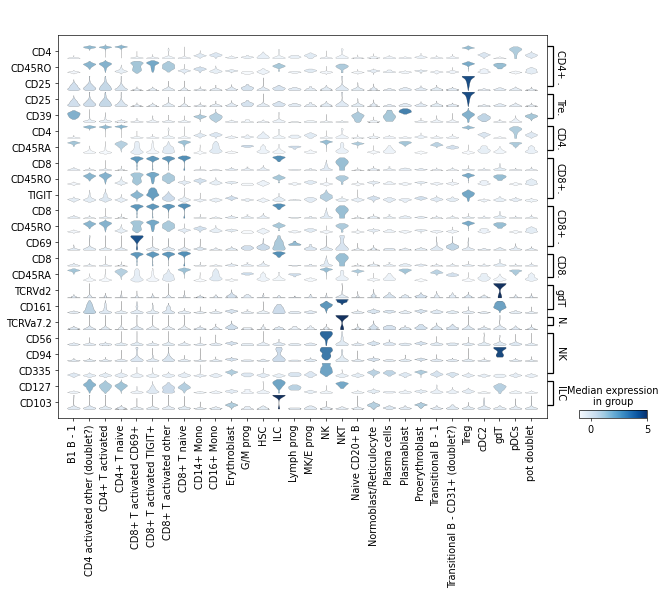

In [266]:
#Overview
adata_plot = adata_adt_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['CD14+ Mono', 'CD16+ Mono', 'cDC2', 'pDCs']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'ILC']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['MK/E prog', 'HSC', 'Lymph prog', 'G/M prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['Proerythroblast', 'Erythroblast', 'Normoblast/Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_prots[a] for a in ['CD4+ T activated', 'Treg', 'CD4+ T naive', 'CD8+ T activated TIGIT+', 'CD8+ T activated CD69+', 'CD8+ T naive', 'gdT', 'NKT', 'NK', 'ILC']})



# Write output

In [267]:
adata_adt_filt

View of AnnData object with n_obs × n_vars = 8058 × 140
    obs: 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'iso_count', 'iso_count_col', 'log_iso_count', 'iso_count_fltr', 'n_counts', 'leiden', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_sub', 'rna_labels', 'leiden_temp', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'rg_res0.5_sub', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs

In [268]:
adata_adt_filt_slim = adata_adt_filt.copy()

In [269]:
adata_adt_filt_slim.obs = adata_adt_filt_slim.obs[['n_antibodies_by_counts', 'total_counts', 'iso_count',
                                                   'leiden_res0.5_sub', 'leiden_final']]

adata_adt_filt_slim.var = adata_adt_filt_slim.var[['gene_ids', 'feature_types', 'genome']]

In [270]:
adata_adt_filt_slim

AnnData object with n_obs × n_vars = 8058 × 140
    obs: 'n_antibodies_by_counts', 'total_counts', 'iso_count', 'leiden_res0.5_sub', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'iso_count_fltr_colors', 'pca', 'neighbors', 'leiden', 'umap', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 'leiden_res1_colors', 'predicted_doublet_colors', 'rank_leiden_res0.5', 'leiden_res0.5_sub_colors', 'rg_res0.5_sub', 'leiden_temp_colors', 'leiden_final_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [271]:
adata_adt_filt_slim.write('data/cite/proc_data/s1d1/Donor1_adt.h5ad')